<a href="https://colab.research.google.com/github/kmu973/Philadelphia_vacant_lot_detection/blob/main/VacantLot_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import Data

In [ ]:
pip install rasterio

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 66.0 MB/s eta 0:00:00


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import tensorflow as tf
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


In [ ]:
import tensorflow as tf
import timeit

device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  print(
      '\n\nThis error most likely means that this notebook is not '
      'configured to use a GPU.  Change this in Notebook Settings via the '
      'command palette (cmd/ctrl-shift-P) or the Edit menu.\n\n')
  raise SystemError('GPU device not found')

def cpu():
  with tf.device('/cpu:0'):
    random_image_cpu = tf.random.normal((100, 100, 100, 3))
    net_cpu = tf.keras.layers.Conv2D(32, 7)(random_image_cpu)
    return tf.math.reduce_sum(net_cpu)

def gpu():
  with tf.device('/device:GPU:0'):
    random_image_gpu = tf.random.normal((100, 100, 100, 3))
    net_gpu = tf.keras.layers.Conv2D(32, 7)(random_image_gpu)
    return tf.math.reduce_sum(net_gpu)
  
# We run each op once to warm up; see: https://stackoverflow.com/a/45067900
cpu()
gpu()

# Run the op several times.
print('Time (s) to convolve 32x7x7x3 filter over random 100x100x100x3 images '
      '(batch x height x width x channel). Sum of ten runs.')
print('CPU (s):')
cpu_time = timeit.timeit('cpu()', number=10, setup="from __main__ import cpu")
print(cpu_time)
print('GPU (s):')
gpu_time = timeit.timeit('gpu()', number=10, setup="from __main__ import gpu")
print(gpu_time)
print('GPU speedup over CPU: {}x'.format(int(cpu_time/gpu_time)))

Time (s) to convolve 32x7x7x3 filter over random 100x100x100x3 images (batch x height x width x channel). Sum of ten runs.
CPU (s):
1.0542414960000315
GPU (s):
0.07243745099981425
GPU speedup over CPU: 14x


## Load all images

In [ ]:
#Load all image, label sets

import os
import rasterio
import numpy as np

def load_tiff_images(folder_path, file_extension=".tif"):
    image_files = sorted([file for file in os.listdir(folder_path) if file.endswith(file_extension)])
    images = []
    
    count = 0  # Initialize counter variable
    for file in image_files:
        file_path = os.path.join(folder_path, file)
        with rasterio.open(file_path) as src:
            image = src.read().transpose(1, 2, 0)  # Reorder dimensions to (height, width, channels)
            images.append(image)
        count += 1  # Increment counter
        print(f"Loaded image {count} of {len(image_files)}: {file}")  # Print image title with count
    
    return np.array(images), image_files

# Load images and labels
train_images_resized_folder = "/content/drive/MyDrive/Remote_Sensing_Project/Train-512/train_images_resized"
val_images_resized_folder = "/content/drive/MyDrive/Remote_Sensing_Project/Train-512/val_images_resized"
train_labels_resized_folder = "/content/drive/MyDrive/Remote_Sensing_Project/Train-512/train_labels_resized"
val_labels_resized_folder = "/content/drive/MyDrive/Remote_Sensing_Project/Train-512/val_labels_resized"

train_images_resized, image_files = load_tiff_images(train_images_resized_folder)  # Shape: (num_images, height, width, 3)
val_images_resized, image_files = load_tiff_images(val_images_resized_folder)  # Shape: (num_images, height, width, 3)
train_labels_resized, label_files = load_tiff_images(train_labels_resized_folder)  # Shape: (num_labels, height, width, 1)
val_labels_resized, label_files = load_tiff_images(val_labels_resized_folder)  # Shape: (num_labels, height, width, 1)


# Ensure labels have 4 dimensions
if len(train_labels_resized.shape) == 3:
    train_labels_resized = train_labels_resized[..., np.newaxis]
if len(val_labels_resized.shape) == 3:
    val_labels_resized = val_labels_resized[..., np.newaxis]


# Print first 5 file names and dataset shapes
print("First 5 image file names:", image_files[:5])
print("First 5 label file names:", label_files[:5])
print("Images shape:", train_images_resized.shape)
print("Labels shape:", train_labels_resized.shape)


KeyboardInterrupt: ignored

## Load Aug 5% / Aug images

In [ ]:
#Load all image, label sets

import os
import rasterio
import numpy as np

def load_tiff_images(folder_path, file_extension=".tif"):
    image_files = sorted([file for file in os.listdir(folder_path) if file.endswith(file_extension)])
    images = []
    
    count = 0  # Initialize counter variable
    for file in image_files:
        file_path = os.path.join(folder_path, file)
        with rasterio.open(file_path) as src:
            image = src.read().transpose(1, 2, 0)  # Reorder dimensions to (height, width, channels)
            images.append(image)
        count += 1  # Increment counter
        print(f"Loaded image {count} of {len(image_files)}: {file}")  # Print image title with count
    
    return np.array(images), image_files

# Load images and labels
train_images_resized_folder = "/content/drive/MyDrive/Remote_Sensing_Project/Train-512-5-Aug/train_images_resized"
val_images_resized_folder = "/content/drive/MyDrive/Remote_Sensing_Project/Train-512-5-Aug/val_images_resized"
train_labels_resized_folder = "/content/drive/MyDrive/Remote_Sensing_Project/Train-512-5-Aug/train_labels_resized"
val_labels_resized_folder = "/content/drive/MyDrive/Remote_Sensing_Project/Train-512-5-Aug/val_labels_resized"

train_images_resized, image_files = load_tiff_images(train_images_resized_folder)  # Shape: (num_images, height, width, 3)
val_images_resized, image_files = load_tiff_images(val_images_resized_folder)  # Shape: (num_images, height, width, 3)
train_labels_resized, label_files = load_tiff_images(train_labels_resized_folder)  # Shape: (num_labels, height, width, 1)
val_labels_resized, label_files = load_tiff_images(val_labels_resized_folder)  # Shape: (num_labels, height, width, 1)


# Ensure labels have 4 dimensions
if len(train_labels_resized.shape) == 3:
    train_labels_resized = train_labels_resized[..., np.newaxis]
if len(val_labels_resized.shape) == 3:
    val_labels_resized = val_labels_resized[..., np.newaxis]


# Print first 5 file names and dataset shapes
print("First 5 image file names:", image_files[:5])
print("First 5 label file names:", label_files[:5])
print("Images shape:", train_images_resized.shape)
print("Labels shape:", train_labels_resized.shape)


Loaded image 1 of 1128: train_image_0.tif
Loaded image 2 of 1128: train_image_1.tif
Loaded image 3 of 1128: train_image_10.tif
Loaded image 4 of 1128: train_image_100.tif
Loaded image 5 of 1128: train_image_1000.tif
Loaded image 6 of 1128: train_image_1001.tif
Loaded image 7 of 1128: train_image_1002.tif
Loaded image 8 of 1128: train_image_1003.tif
Loaded image 9 of 1128: train_image_1004.tif
Loaded image 10 of 1128: train_image_1005.tif
Loaded image 11 of 1128: train_image_1006.tif
Loaded image 12 of 1128: train_image_1007.tif
Loaded image 13 of 1128: train_image_1008.tif
Loaded image 14 of 1128: train_image_1009.tif
Loaded image 15 of 1128: train_image_101.tif
Loaded image 16 of 1128: train_image_1010.tif
Loaded image 17 of 1128: train_image_1011.tif
Loaded image 18 of 1128: train_image_1012.tif
Loaded image 19 of 1128: train_image_1013.tif
Loaded image 20 of 1128: train_image_1014.tif
Loaded image 21 of 1128: train_image_1015.tif
Loaded image 22 of 1128: train_image_1016.tif
Loaded 

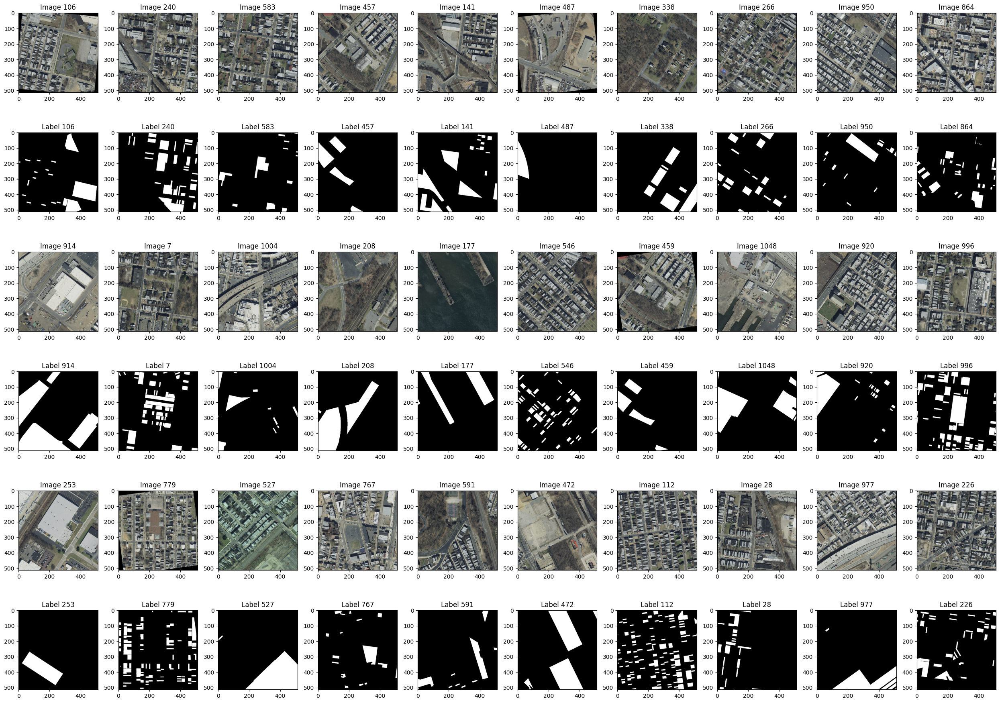

In [ ]:
import matplotlib.pyplot as plt

def plot_image_and_label(images, labels, index, ax):
    ax[0].imshow(images[index])
    ax[0].set_title(f"Image {index+1}")

    ax[1].imshow(labels[index].squeeze(), cmap="gray")
    ax[1].set_title(f"Label {index+1}")

# Plot 20 image and label pairs with 5 pairs per column
num_pairs_to_plot = 60
num_columns = 10
num_rows = num_pairs_to_plot // num_columns

fig, axes = plt.subplots(num_rows * 2, num_columns, figsize=(25, num_rows * 6))

for i in range(num_pairs_to_plot):
    row = i // num_columns
    col = i % num_columns
    plot_image_and_label(train_images_resized, train_labels_resized, i, (axes[row * 2, col], axes[row * 2 + 1, col]))

plt.tight_layout()
plt.show()

# Model 1 : UNET

### UNET / 2000*2000 / Epoch 1 

In [ ]:
import numpy as np
import tensorflow as tf
from google.colab import files
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate

def unet(input_shape):
    inputs = Input(input_shape)

    # Contracting path
    c1 = Conv2D(16, (3, 3), activation="relu", padding="same")(inputs)
    c1 = Conv2D(16, (3, 3), activation="relu", padding="same")(c1)
    p1 = MaxPooling2D((2, 2))(c1)

    c2 = Conv2D(32, (3, 3), activation="relu", padding="same")(p1)
    c2 = Conv2D(32, (3, 3), activation="relu", padding="same")(c2)
    p2 = MaxPooling2D((2, 2))(c2)

    c3 = Conv2D(64, (3, 3), activation="relu", padding="same")(p2)
    c3 = Conv2D(64, (3, 3), activation="relu", padding="same")(c3)
    p3 = MaxPooling2D((2, 2))(c3)

    c4 = Conv2D(128, (3, 3), activation="relu", padding="same")(p3)
    c4 = Conv2D(128, (3, 3), activation="relu", padding="same")(c4)
    p4 = MaxPooling2D((2, 2))(c4)

    c5 = Conv2D(256, (3, 3), activation="relu", padding="same")(p4)
    c5 = Conv2D(256, (3, 3), activation="relu", padding="same")(c5)

    # Expanding path
    u6 = UpSampling2D((2, 2))(c5)
    u6 = concatenate([u6, c4])
    c6 = Conv2D(128, (3, 3), activation="relu", padding="same")(u6)
    c6 = Conv2D(128, (3, 3), activation="relu", padding="same")(c6)

    u7 = UpSampling2D((2, 2))(c6)
    u7 = concatenate([u7, c3])
    c7 = Conv2D(64, (3, 3), activation="relu", padding="same")(u7)
    c7 = Conv2D(64, (3, 3), activation="relu", padding="same")(c7)

    u8 = UpSampling2D((2, 2))(c7)
    u8 = concatenate([u8, c2])
    c8 = Conv2D(32, (3, 3), activation="relu", padding="same")(u8)
    c8 = Conv2D(32, (3, 3), activation="relu", padding="same")(c8)

    u9 = UpSampling2D((2, 2))(c8)
    u9 = concatenate([u9, c1])
    c9 = Conv2D(16, (3, 3), activation="relu", padding="same")(u9)
    c9 = Conv2D(16, (3, 3), activation="relu", padding="same")(c9)

    outputs = Conv2D(1, (1, 1), activation="sigmoid")(c9)

    return Model(inputs=inputs, outputs=outputs)

# Create and compile the model
input_shape = (2000, 2000, 3)
model = unet(input_shape)
model.compile(optimizer="adam", loss="binary_crossentropy", metrics=["accuracy"])

# Train the model
epochs = 1
batch_size = 4
history = model.fit(
    train_images, train_labels,
    validation_data=(val_images, val_labels),
    epochs=epochs,
    batch_size=batch_size
)

from google.colab import files
files.download("vacant_lot_segmentation_model_100_1epc.h5")

model.save("/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_100_1epc.h5")

# Save the trained model
# model.save("vacant_lot_segmentation_model_100_1epc.h5")


### UNET / 512*512 / Epoch 2000

In [ ]:
import numpy as np
import tensorflow as tf
from google.colab import files
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate

# U-Net implementation
def unet(input_shape):
    inputs = Input(input_shape)

    # Contracting path
    c1 = Conv2D(16, (3, 3), activation="relu", padding="same")(inputs)
    c1 = Conv2D(16, (3, 3), activation="relu", padding="same")(c1)
    p1 = MaxPooling2D((2, 2))(c1)

    c2 = Conv2D(32, (3, 3), activation="relu", padding="same")(p1)
    c2 = Conv2D(32, (3, 3), activation="relu", padding="same")(c2)
    p2 = MaxPooling2D((2, 2))(c2)

    c3 = Conv2D(64, (3, 3), activation="relu", padding="same")(p2)
    c3 = Conv2D(64, (3, 3), activation="relu", padding="same")(c3)
    p3 = MaxPooling2D((2, 2))(c3)

    c4 = Conv2D(128, (3, 3), activation="relu", padding="same")(p3)
    c4 = Conv2D(128, (3, 3), activation="relu", padding="same")(c4)
    p4 = MaxPooling2D((2, 2))(c4)

    c5 = Conv2D(256, (3, 3), activation="relu", padding="same")(p4)
    c5 = Conv2D(256, (3, 3), activation="relu", padding="same")(c5)

     # Expanding path
    u6 = UpSampling2D((2, 2))(c5)
    u6 = concatenate([u6, c4])
    c6 = Conv2D(128, (3, 3), activation="relu", padding="same")(u6)
    c6 = Conv2D(128, (3, 3), activation="relu", padding="same")(c6)

    u7 = UpSampling2D((2, 2))(c6)
    u7 = concatenate([u7, c3])
    c7 = Conv2D(64, (3, 3), activation="relu", padding="same")(u7)
    c7 = Conv2D(64, (3, 3), activation="relu", padding="same")(c7)

    u8 = UpSampling2D((2, 2))(c7)
    u8 = concatenate([u8, c2])
    c8 = Conv2D(32, (3, 3), activation="relu", padding="same")(u8)
    c8 = Conv2D(32, (3, 3), activation="relu", padding="same")(c8)

    u9 = UpSampling2D((2, 2))(c8)
    u9 = concatenate([u9, c1])
    c9 = Conv2D(16, (3, 3), activation="relu", padding="same")(u9)
    c9 = Conv2D(16, (3, 3), activation="relu", padding="same")(c9)

    outputs = Conv2D(1, (1, 1), activation="sigmoid")(c9)

    return Model(inputs=inputs, outputs=outputs)

# Create and compile the model
input_shape = (512, 512, 3)
model = unet(input_shape)
model.compile(optimizer="adam", loss="binary_crossentropy", metrics=["accuracy"])

# Train the model
epochs = 2000
batch_size = 4
history = model.fit(
    train_images_resized, train_labels_resized,
    validation_data=(val_images_resized, val_labels_resized),
    epochs=epochs,
    batch_size=batch_size
)

# Save the trained model
model_filename = "vacant_lot_segmentation_model_512_2000epc.h5"
model.save(model_filename)

# Download the model file
files.download(model_filename)

# Save the model to Google Drive
model.save("/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_512_2000epc.h5")

gc.collect()


### UNET / 512*512 / Epoch 1000

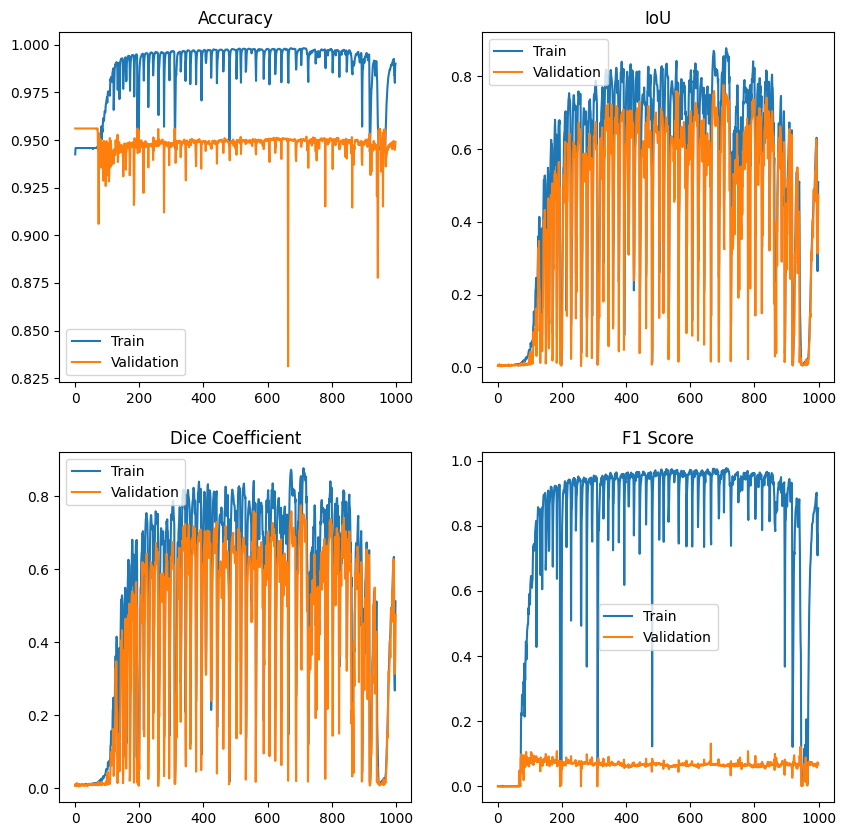

200/200 [==============================] - 6s 32ms/step - loss: 0.0280 - accuracy: 0.9902 - iou: 0.5090 - dice_coef: 0.5123 - f1_score: 0.8533 - val_loss: 1.1452 - val_accuracy: 0.9491 - val_iou: 0.4745 - val_dice_coef: 0.4751 - val_f1_score: 0.0667


72213

In [ ]:
import numpy as np
import tensorflow as tf
from google.colab import files
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate
import matplotlib.pyplot as plt
import json
import gc
from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import EarlyStopping, Callback
from IPython.display import clear_output


def iou(y_true, y_pred):
    intersection = K.sum(K.abs(y_true * y_pred), axis=-1)
    union = K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) - intersection
    return (intersection + K.epsilon()) / (union + K.epsilon())

def dice_coef(y_true, y_pred):
    intersection = K.sum(y_true * y_pred, axis=-1)
    return (2. * intersection + K.epsilon()) / (K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) + K.epsilon())

def f1_score(y_true, y_pred):
    precision = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_pred, 0, 1))) + K.epsilon())
    recall = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_true, 0, 1))) + K.epsilon())
    return 2 * (precision * recall) / (precision + recall + K.epsilon())

class PlotMetricsCallback(Callback):
    def on_train_begin(self, logs=None):
        self.metrics = {"accuracy": [], "val_accuracy": [], "iou": [], "val_iou": [], "dice_coef": [], "val_dice_coef": [], "f1_score": [], "val_f1_score": []}

    def on_epoch_end(self, epoch, logs=None):
        for metric in self.metrics:
            self.metrics[metric].append(logs.get(metric))

        clear_output(wait=True)
        fig, axes = plt.subplots(2, 2, figsize=(10, 10))

        axes[0, 0].plot(self.metrics["accuracy"], label="Train")
        axes[0, 0].plot(self.metrics["val_accuracy"], label="Validation")
        axes[0, 0].set_title("Accuracy")
        axes[0, 0].legend()

        axes[0, 1].plot(self.metrics["iou"], label="Train")
        axes[0, 1].plot(self.metrics["val_iou"], label="Validation")
        axes[0, 1].set_title("IoU")
        axes[0, 1].legend()

        axes[1, 0].plot(self.metrics["dice_coef"], label="Train")
        axes[1, 0].plot(self.metrics["val_dice_coef"], label="Validation")
        axes[1, 0].set_title("Dice Coefficient")
        axes[1, 0].legend()

        axes[1, 1].plot(self.metrics["f1_score"], label="Train")
        axes[1, 1].plot(self.metrics["val_f1_score"], label="Validation")
        axes[1, 1].set_title("F1 Score")
        axes[1, 1].legend()

        plt.show()

plot_metrics_callback = PlotMetricsCallback()


# U-Net implementation
def unet(input_shape):
    inputs = Input(input_shape)

    # Contracting path
    c1 = Conv2D(16, (3, 3), activation="relu", padding="same")(inputs)
    c1 = Conv2D(16, (3, 3), activation="relu", padding="same")(c1)
    p1 = MaxPooling2D((2, 2))(c1)

    c2 = Conv2D(32, (3, 3), activation="relu", padding="same")(p1)
    c2 = Conv2D(32, (3, 3), activation="relu", padding="same")(c2)
    p2 = MaxPooling2D((2, 2))(c2)

    c3 = Conv2D(64, (3, 3), activation="relu", padding="same")(p2)
    c3 = Conv2D(64, (3, 3), activation="relu", padding="same")(c3)
    p3 = MaxPooling2D((2, 2))(c3)

    c4 = Conv2D(128, (3, 3), activation="relu", padding="same")(p3)
    c4 = Conv2D(128, (3, 3), activation="relu", padding="same")(c4)
    p4 = MaxPooling2D((2, 2))(c4)

    c5 = Conv2D(256, (3, 3), activation="relu", padding="same")(p4)
    c5 = Conv2D(256, (3, 3), activation="relu", padding="same")(c5)

     # Expanding path
    u6 = UpSampling2D((2, 2))(c5)
    u6 = concatenate([u6, c4])
    c6 = Conv2D(128, (3, 3), activation="relu", padding="same")(u6)
    c6 = Conv2D(128, (3, 3), activation="relu", padding="same")(c6)

    u7 = UpSampling2D((2, 2))(c6)
    u7 = concatenate([u7, c3])
    c7 = Conv2D(64, (3, 3), activation="relu", padding="same")(u7)
    c7 = Conv2D(64, (3, 3), activation="relu", padding="same")(c7)

    u8 = UpSampling2D((2, 2))(c7)
    u8 = concatenate([u8, c2])
    c8 = Conv2D(32, (3, 3), activation="relu", padding="same")(u8)
    c8 = Conv2D(32, (3, 3), activation="relu", padding="same")(c8)

    u9 = UpSampling2D((2, 2))(c8)
    u9 = concatenate([u9, c1])
    c9 = Conv2D(16, (3, 3), activation="relu", padding="same")(u9)
    c9 = Conv2D(16, (3, 3), activation="relu", padding="same")(c9)

    outputs = Conv2D(1, (1, 1), activation="sigmoid")(c9)

    return Model(inputs=inputs, outputs=outputs)

# Create and compile the model
input_shape = (512, 512, 3)
early_stopping = EarlyStopping(monitor='val_loss', patience=50, mode='min')
model = unet(input_shape)
model.compile(optimizer="adam", loss="binary_crossentropy", metrics=["accuracy", iou, dice_coef, f1_score])


# Train the model
epochs = 1000
batch_size = 4
history = model.fit(
    train_images_resized, train_labels_resized,
    validation_data=(val_images_resized, val_labels_resized),
    epochs=epochs,
    batch_size=batch_size,
    callbacks=[plot_metrics_callback]
    # callbacks=[early_stopping, plot_metrics_callback]
)


# Save the model to Google Drive
model.save("/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_512_1000epc_0425.h5")

# Save the history file to Google Drive
with open("/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_512_1000epc_history_data_0425.json", "w") as outfile:
    json.dump(history.history, outfile)

gc.collect()


         loss  accuracy       iou  dice_coef      f1_score  val_loss  \
0    0.222887  0.942471  0.005180   0.008865  4.233235e-04  0.185540   
1    0.204570  0.945796  0.005144   0.009040  0.000000e+00  0.206302   
2    0.206904  0.945796  0.004895   0.008687  5.534646e-07  0.192928   
3    0.195679  0.945795  0.005161   0.009157  1.885522e-06  0.174330   
4    0.199837  0.945796  0.004963   0.008841  0.000000e+00  0.175717   
..        ...       ...       ...        ...           ...       ...   
995  0.051347  0.984055  0.474545   0.477981  7.821470e-01  1.092076   
996  0.047997  0.983996  0.299588   0.303143  7.721479e-01  0.742958   
997  0.060892  0.980043  0.264434   0.268142  7.088236e-01  0.846389   
998  0.033327  0.988345  0.422584   0.426093  8.396045e-01  0.905442   
999  0.028039  0.990150  0.509007   0.512343  8.533323e-01  1.145236   

     val_accuracy   val_iou  val_dice_coef  val_f1_score  
0        0.956072  0.003772       0.006831      0.000000  
1        0.956072

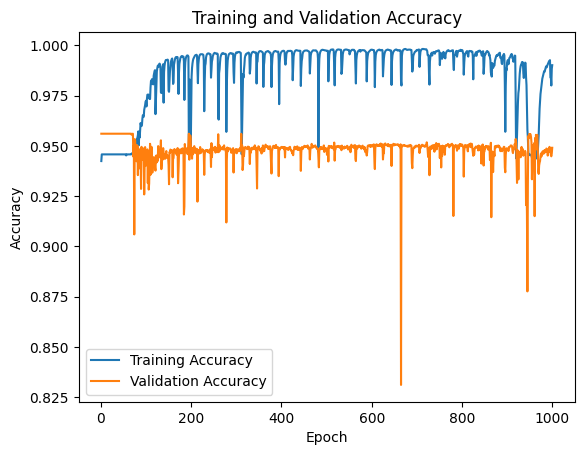

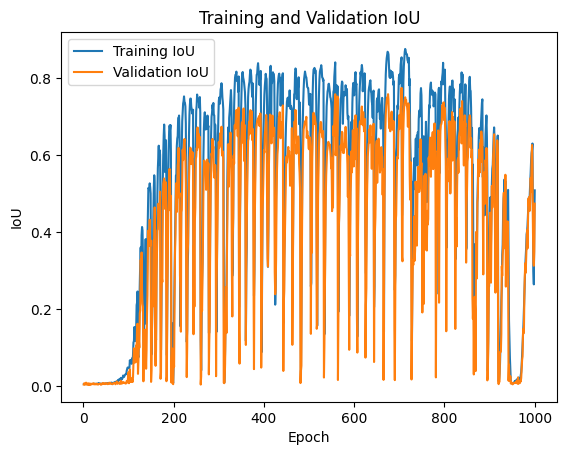

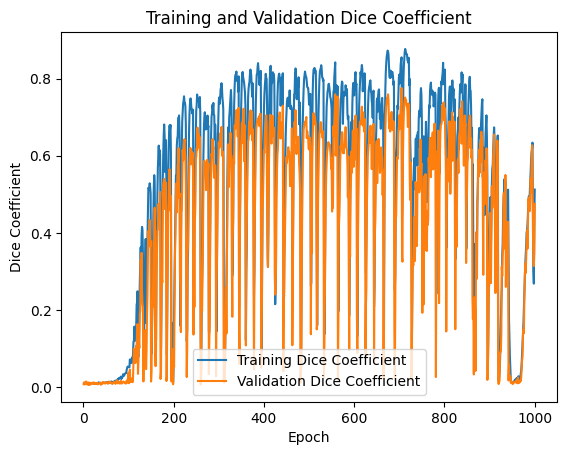

In [ ]:
import json
import pandas as pd
import matplotlib.pyplot as plt

# Load history data from a JSON file
history_filepath = "/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_512_1000epc_history_data_0425.json"
with open(history_filepath, "r") as infile:
    history_data = json.load(infile)

# Convert loaded history data to integers for epochs
history_data = {key: [float(value) for value in values] for key, values in history_data.items()}

# Create a DataFrame from the history data
history_df = pd.DataFrame(history_data)

# Display the table of each metric
print(history_df)

# Plot the accuracy of each epoch using the loaded history data
plt.figure()
plt.plot(range(1, len(history_data["accuracy"]) + 1), history_data["accuracy"], label="Training Accuracy")
plt.plot(range(1, len(history_data["val_accuracy"]) + 1), history_data["val_accuracy"], label="Validation Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend()
plt.title("Training and Validation Accuracy")
plt.show()

# Plot the IoU of each epoch using the loaded history data
plt.figure()
plt.plot(range(1, len(history_data["iou"]) + 1), history_data["iou"], label="Training IoU")
plt.plot(range(1, len(history_data["val_iou"]) + 1), history_data["val_iou"], label="Validation IoU")
plt.xlabel("Epoch")
plt.ylabel("IoU")
plt.legend()
plt.title("Training and Validation IoU")
plt.show()

# Plot the Dice Coefficient of each epoch using the loaded history data
plt.figure()
plt.plot(range(1, len(history_data["dice_coef"]) + 1), history_data["dice_coef"], label="Training Dice Coefficient")
plt.plot(range(1, len(history_data["val_dice_coef"]) + 1), history_data["val_dice_coef"], label="Validation Dice Coefficient")
plt.xlabel("Epoch")
plt.ylabel("Dice Coefficient")
plt.legend()
plt.title("Training and Validation Dice Coefficient")
plt.show()


### UNET / 512*512 / Epoch 500 / 5% / Aug

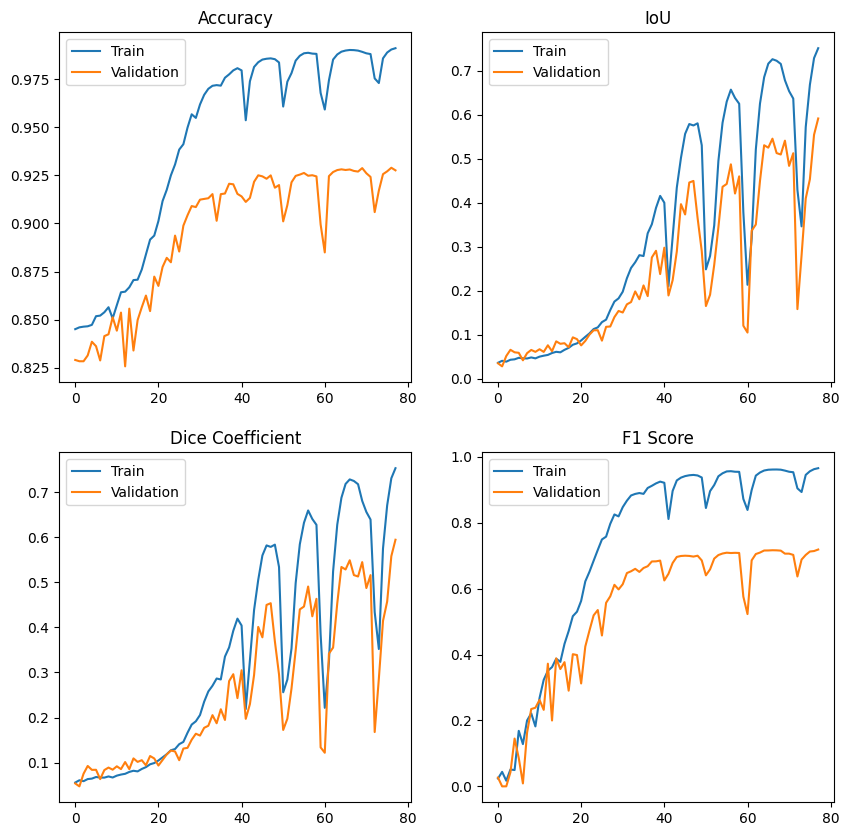

282/282 [==============================] - 9s 31ms/step - loss: 0.0219 - accuracy: 0.9910 - iou: 0.7513 - dice_coef: 0.7533 - f1_score: 0.9653 - val_loss: 0.5715 - val_accuracy: 0.9276 - val_iou: 0.5915 - val_dice_coef: 0.5945 - val_f1_score: 0.7185


62730

In [ ]:
import numpy as np
import tensorflow as tf
from google.colab import files
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate
import matplotlib.pyplot as plt
import json
import gc
from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import EarlyStopping, Callback
from IPython.display import clear_output


def iou(y_true, y_pred):
    intersection = K.sum(K.abs(y_true * y_pred), axis=-1)
    union = K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) - intersection
    return (intersection + K.epsilon()) / (union + K.epsilon())

def dice_coef(y_true, y_pred):
    intersection = K.sum(y_true * y_pred, axis=-1)
    return (2. * intersection + K.epsilon()) / (K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) + K.epsilon())

def f1_score(y_true, y_pred):
    precision = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_pred, 0, 1))) + K.epsilon())
    recall = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_true, 0, 1))) + K.epsilon())
    return 2 * (precision * recall) / (precision + recall + K.epsilon())

class PlotMetricsCallback(Callback):
    def on_train_begin(self, logs=None):
        self.metrics = {"accuracy": [], "val_accuracy": [], "iou": [], "val_iou": [], "dice_coef": [], "val_dice_coef": [], "f1_score": [], "val_f1_score": []}

    def on_epoch_end(self, epoch, logs=None):
        for metric in self.metrics:
            self.metrics[metric].append(logs.get(metric))

        clear_output(wait=True)
        fig, axes = plt.subplots(2, 2, figsize=(10, 10))

        axes[0, 0].plot(self.metrics["accuracy"], label="Train")
        axes[0, 0].plot(self.metrics["val_accuracy"], label="Validation")
        axes[0, 0].set_title("Accuracy")
        axes[0, 0].legend()

        axes[0, 1].plot(self.metrics["iou"], label="Train")
        axes[0, 1].plot(self.metrics["val_iou"], label="Validation")
        axes[0, 1].set_title("IoU")
        axes[0, 1].legend()

        axes[1, 0].plot(self.metrics["dice_coef"], label="Train")
        axes[1, 0].plot(self.metrics["val_dice_coef"], label="Validation")
        axes[1, 0].set_title("Dice Coefficient")
        axes[1, 0].legend()

        axes[1, 1].plot(self.metrics["f1_score"], label="Train")
        axes[1, 1].plot(self.metrics["val_f1_score"], label="Validation")
        axes[1, 1].set_title("F1 Score")
        axes[1, 1].legend()

        plt.show()

plot_metrics_callback = PlotMetricsCallback()


# U-Net implementation
def unet(input_shape):
    inputs = Input(input_shape)

    # Contracting path
    c1 = Conv2D(16, (3, 3), activation="relu", padding="same")(inputs)
    c1 = Conv2D(16, (3, 3), activation="relu", padding="same")(c1)
    p1 = MaxPooling2D((2, 2))(c1)

    c2 = Conv2D(32, (3, 3), activation="relu", padding="same")(p1)
    c2 = Conv2D(32, (3, 3), activation="relu", padding="same")(c2)
    p2 = MaxPooling2D((2, 2))(c2)

    c3 = Conv2D(64, (3, 3), activation="relu", padding="same")(p2)
    c3 = Conv2D(64, (3, 3), activation="relu", padding="same")(c3)
    p3 = MaxPooling2D((2, 2))(c3)

    c4 = Conv2D(128, (3, 3), activation="relu", padding="same")(p3)
    c4 = Conv2D(128, (3, 3), activation="relu", padding="same")(c4)
    p4 = MaxPooling2D((2, 2))(c4)

    c5 = Conv2D(256, (3, 3), activation="relu", padding="same")(p4)
    c5 = Conv2D(256, (3, 3), activation="relu", padding="same")(c5)

     # Expanding path
    u6 = UpSampling2D((2, 2))(c5)
    u6 = concatenate([u6, c4])
    c6 = Conv2D(128, (3, 3), activation="relu", padding="same")(u6)
    c6 = Conv2D(128, (3, 3), activation="relu", padding="same")(c6)

    u7 = UpSampling2D((2, 2))(c6)
    u7 = concatenate([u7, c3])
    c7 = Conv2D(64, (3, 3), activation="relu", padding="same")(u7)
    c7 = Conv2D(64, (3, 3), activation="relu", padding="same")(c7)

    u8 = UpSampling2D((2, 2))(c7)
    u8 = concatenate([u8, c2])
    c8 = Conv2D(32, (3, 3), activation="relu", padding="same")(u8)
    c8 = Conv2D(32, (3, 3), activation="relu", padding="same")(c8)

    u9 = UpSampling2D((2, 2))(c8)
    u9 = concatenate([u9, c1])
    c9 = Conv2D(16, (3, 3), activation="relu", padding="same")(u9)
    c9 = Conv2D(16, (3, 3), activation="relu", padding="same")(c9)

    outputs = Conv2D(1, (1, 1), activation="sigmoid")(c9)

    return Model(inputs=inputs, outputs=outputs)

# Create and compile the model
input_shape = (512, 512, 3)
early_stopping = EarlyStopping(monitor='val_loss', patience=50, mode='min')
model = unet(input_shape)
model.compile(optimizer="adam", loss="binary_crossentropy", metrics=["accuracy", iou, dice_coef, f1_score])


# Train the model
epochs = 500
batch_size = 4
history = model.fit(
    train_images_resized, train_labels_resized,
    validation_data=(val_images_resized, val_labels_resized),
    epochs=epochs,
    batch_size=batch_size,
    # callbacks=[plot_metrics_callback]
    callbacks=[early_stopping, plot_metrics_callback]
)


# Save the model to Google Drive
model.save("/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_512_5_Aug_500epc_0425.h5")

# Save the history file to Google Drive
with open("/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_512_5_Aug_500epc_history_data_0425.json", "w") as outfile:
    json.dump(history.history, outfile)

gc.collect()


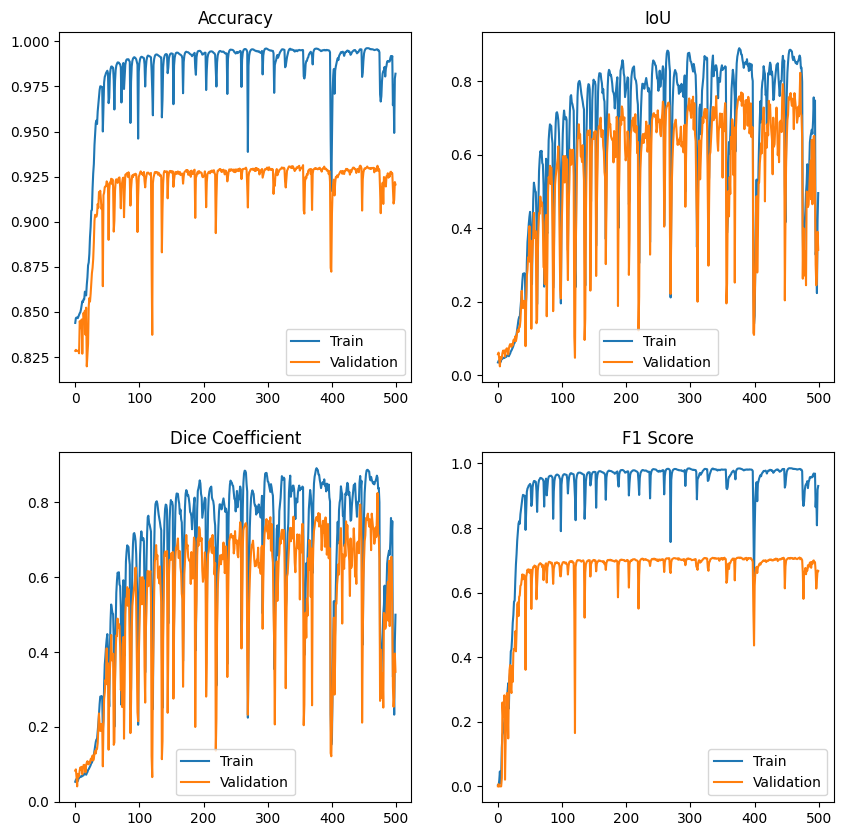

282/282 [==============================] - 9s 31ms/step - loss: 0.0466 - accuracy: 0.9821 - iou: 0.4957 - dice_coef: 0.4997 - f1_score: 0.9304 - val_loss: 0.4658 - val_accuracy: 0.9207 - val_iou: 0.3412 - val_dice_coef: 0.3470 - val_f1_score: 0.6670


100429

In [ ]:
import numpy as np
import tensorflow as tf
from google.colab import files
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate
import matplotlib.pyplot as plt
import json
import gc
from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import EarlyStopping, Callback
from IPython.display import clear_output


def iou(y_true, y_pred):
    intersection = K.sum(K.abs(y_true * y_pred), axis=-1)
    union = K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) - intersection
    return (intersection + K.epsilon()) / (union + K.epsilon())

def dice_coef(y_true, y_pred):
    intersection = K.sum(y_true * y_pred, axis=-1)
    return (2. * intersection + K.epsilon()) / (K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) + K.epsilon())

def f1_score(y_true, y_pred):
    precision = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_pred, 0, 1))) + K.epsilon())
    recall = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_true, 0, 1))) + K.epsilon())
    return 2 * (precision * recall) / (precision + recall + K.epsilon())

class PlotMetricsCallback(Callback):
    def on_train_begin(self, logs=None):
        self.metrics = {"accuracy": [], "val_accuracy": [], "iou": [], "val_iou": [], "dice_coef": [], "val_dice_coef": [], "f1_score": [], "val_f1_score": []}

    def on_epoch_end(self, epoch, logs=None):
        for metric in self.metrics:
            self.metrics[metric].append(logs.get(metric))

        clear_output(wait=True)
        fig, axes = plt.subplots(2, 2, figsize=(10, 10))

        axes[0, 0].plot(self.metrics["accuracy"], label="Train")
        axes[0, 0].plot(self.metrics["val_accuracy"], label="Validation")
        axes[0, 0].set_title("Accuracy")
        axes[0, 0].legend()

        axes[0, 1].plot(self.metrics["iou"], label="Train")
        axes[0, 1].plot(self.metrics["val_iou"], label="Validation")
        axes[0, 1].set_title("IoU")
        axes[0, 1].legend()

        axes[1, 0].plot(self.metrics["dice_coef"], label="Train")
        axes[1, 0].plot(self.metrics["val_dice_coef"], label="Validation")
        axes[1, 0].set_title("Dice Coefficient")
        axes[1, 0].legend()

        axes[1, 1].plot(self.metrics["f1_score"], label="Train")
        axes[1, 1].plot(self.metrics["val_f1_score"], label="Validation")
        axes[1, 1].set_title("F1 Score")
        axes[1, 1].legend()

        plt.show()

plot_metrics_callback = PlotMetricsCallback()


# U-Net implementation
def unet(input_shape):
    inputs = Input(input_shape)

    # Contracting path
    c1 = Conv2D(16, (3, 3), activation="relu", padding="same")(inputs)
    c1 = Conv2D(16, (3, 3), activation="relu", padding="same")(c1)
    p1 = MaxPooling2D((2, 2))(c1)

    c2 = Conv2D(32, (3, 3), activation="relu", padding="same")(p1)
    c2 = Conv2D(32, (3, 3), activation="relu", padding="same")(c2)
    p2 = MaxPooling2D((2, 2))(c2)

    c3 = Conv2D(64, (3, 3), activation="relu", padding="same")(p2)
    c3 = Conv2D(64, (3, 3), activation="relu", padding="same")(c3)
    p3 = MaxPooling2D((2, 2))(c3)

    c4 = Conv2D(128, (3, 3), activation="relu", padding="same")(p3)
    c4 = Conv2D(128, (3, 3), activation="relu", padding="same")(c4)
    p4 = MaxPooling2D((2, 2))(c4)

    c5 = Conv2D(256, (3, 3), activation="relu", padding="same")(p4)
    c5 = Conv2D(256, (3, 3), activation="relu", padding="same")(c5)

     # Expanding path
    u6 = UpSampling2D((2, 2))(c5)
    u6 = concatenate([u6, c4])
    c6 = Conv2D(128, (3, 3), activation="relu", padding="same")(u6)
    c6 = Conv2D(128, (3, 3), activation="relu", padding="same")(c6)

    u7 = UpSampling2D((2, 2))(c6)
    u7 = concatenate([u7, c3])
    c7 = Conv2D(64, (3, 3), activation="relu", padding="same")(u7)
    c7 = Conv2D(64, (3, 3), activation="relu", padding="same")(c7)

    u8 = UpSampling2D((2, 2))(c7)
    u8 = concatenate([u8, c2])
    c8 = Conv2D(32, (3, 3), activation="relu", padding="same")(u8)
    c8 = Conv2D(32, (3, 3), activation="relu", padding="same")(c8)

    u9 = UpSampling2D((2, 2))(c8)
    u9 = concatenate([u9, c1])
    c9 = Conv2D(16, (3, 3), activation="relu", padding="same")(u9)
    c9 = Conv2D(16, (3, 3), activation="relu", padding="same")(c9)

    outputs = Conv2D(1, (1, 1), activation="sigmoid")(c9)

    return Model(inputs=inputs, outputs=outputs)

# Create and compile the model
input_shape = (512, 512, 3)
early_stopping = EarlyStopping(monitor='val_loss', patience=20, mode='min')
model = unet(input_shape)
model.compile(optimizer="adam", loss="binary_crossentropy", metrics=["accuracy", iou, dice_coef, f1_score])


# Train the model
epochs = 500
batch_size = 4
history = model.fit(
    train_images_resized, train_labels_resized,
    validation_data=(val_images_resized, val_labels_resized),
    epochs=epochs,
    batch_size=batch_size,
    # callbacks=[plot_metrics_callback]
    callbacks=[early_stopping, plot_metrics_callback]
)


# Save the model to Google Drive
model.save("/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_512_5_Aug_500epc_0425.h5")

# Save the history file to Google Drive
with open("/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_512_5_Aug_500epc_history_data_0425.json", "w") as outfile:
    json.dump(history.history, outfile)

gc.collect()


### Predict


36/36 [==============================] - 28s 362ms/step


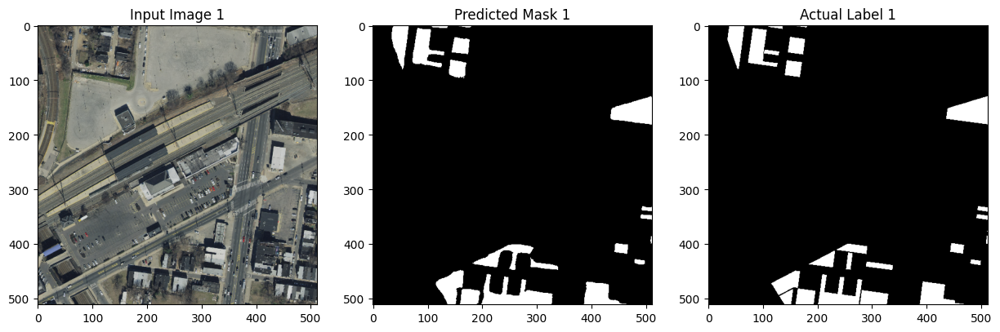

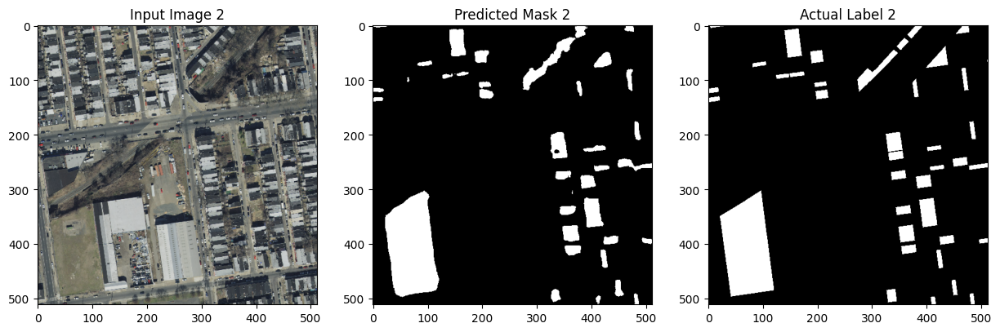

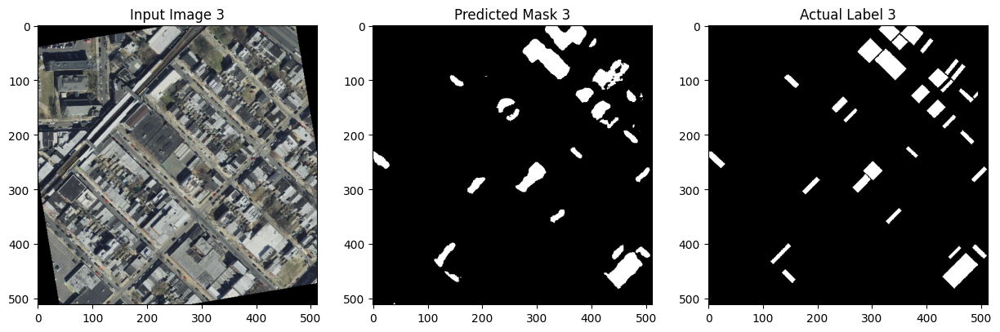

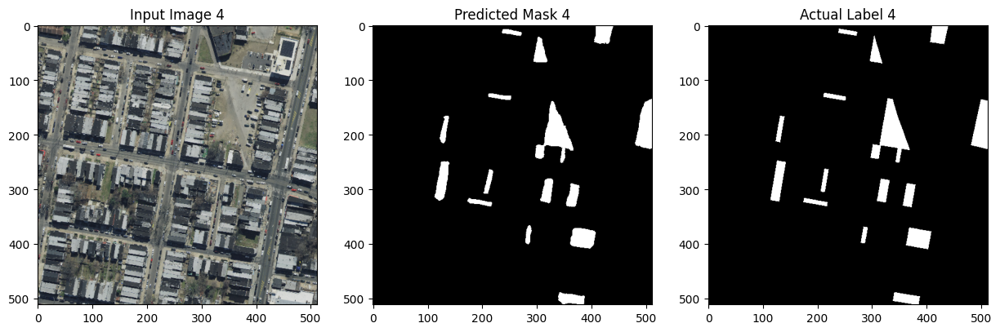

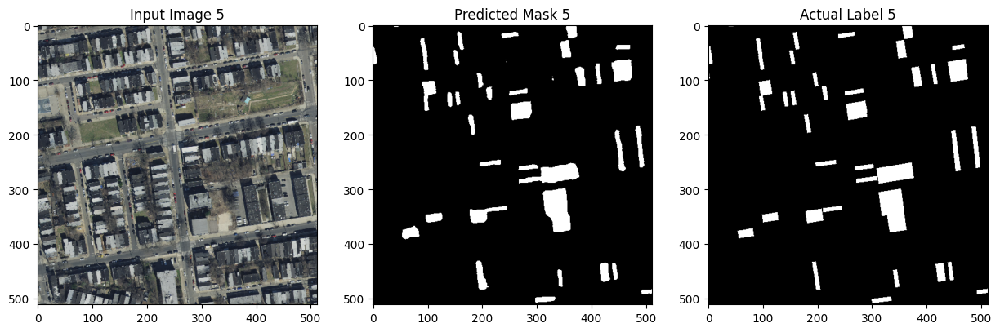

...

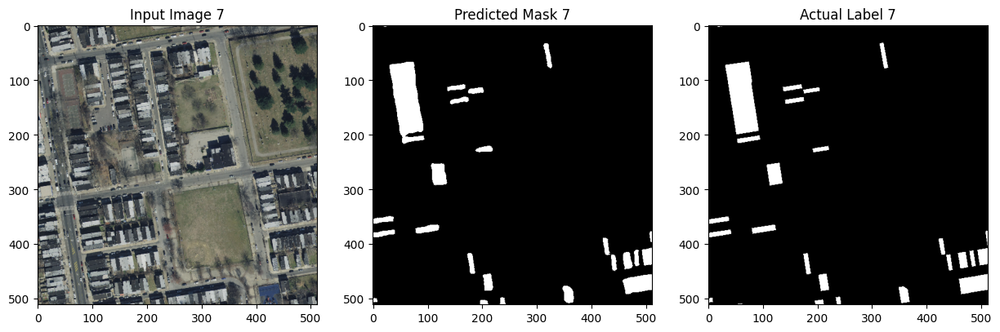

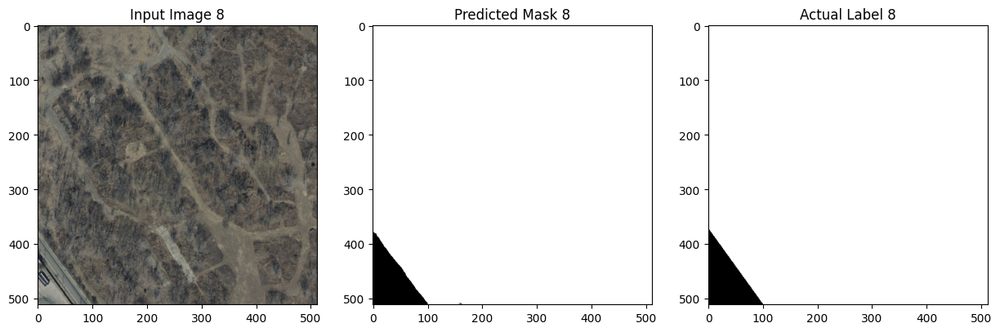

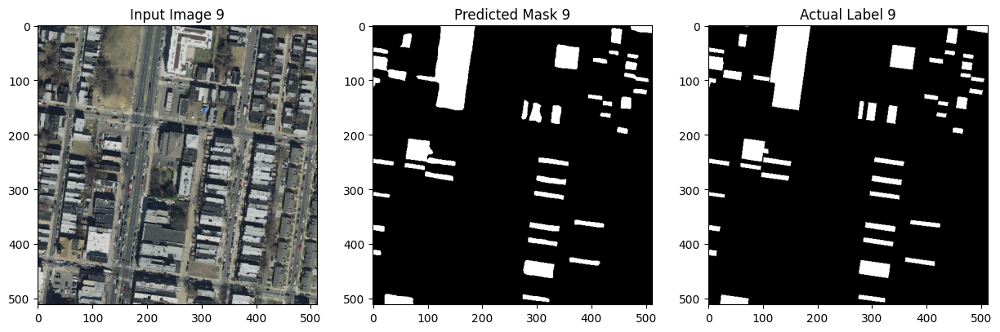

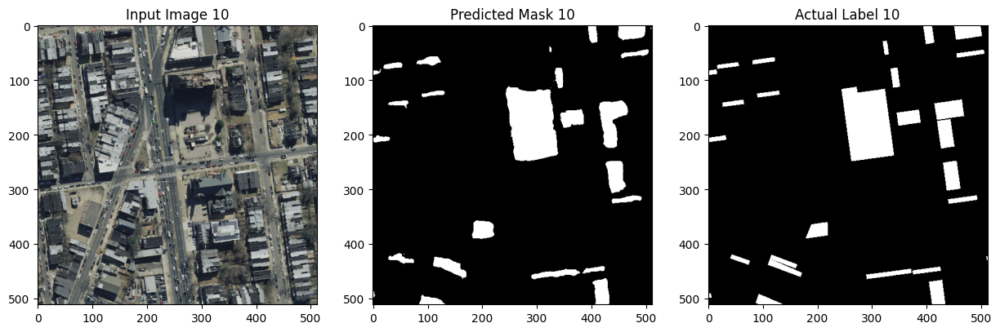

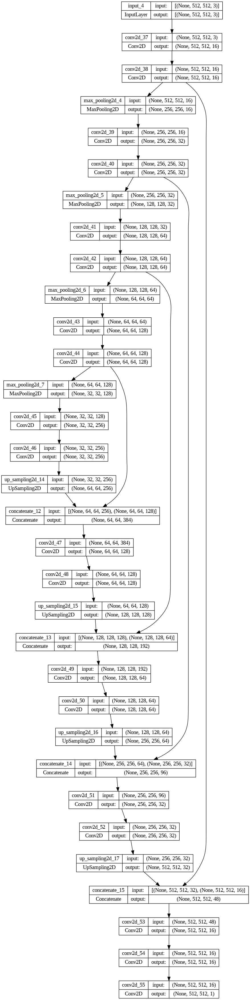

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt
import random


# Define the custom metric functions
def iou(y_true, y_pred):
    intersection = K.sum(K.abs(y_true * y_pred), axis=-1)
    union = K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) - intersection
    return (intersection + K.epsilon()) / (union + K.epsilon())

def dice_coef(y_true, y_pred):
    intersection = K.sum(y_true * y_pred, axis=-1)
    return (2. * intersection + K.epsilon()) / (K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) + K.epsilon())

def f1_score(y_true, y_pred):
    precision = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_pred, 0, 1))) + K.epsilon())
    recall = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_true, 0, 1))) + K.epsilon())
    return 2 * (precision * recall) / (precision + recall + K.epsilon())

# Load the saved model with custom metrics
model_path = "/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_512_5_Aug_500epc_0425.h5"
model = load_model(model_path, custom_objects={'iou': iou, 'dice_coef': dice_coef, 'f1_score': f1_score})

# Predict the masks for the entire train data set
predictions = model.predict(train_images_resized)

# Process the predictions
threshold = 0.5
binary_predictions = (predictions > threshold).astype(np.uint8) * 255

# Choose 10 random indices from the train data set
num_samples = 10
random_indices = random.sample(range(len(train_images_resized)), num_samples)

# Display the input images, predicted masks, and actual labels for the chosen indices
for i, index in enumerate(random_indices):
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(train_images_resized[index])
    plt.title(f"Input Image {i + 1}")

    plt.subplot(1, 3, 2)
    plt.imshow(binary_predictions[index].squeeze(), cmap="gray")
    plt.title(f"Predicted Mask {i + 1}")

    plt.subplot(1, 3, 3)
    plt.imshow(train_labels_resized[index].squeeze(), cmap="gray")
    plt.title(f"Actual Label {i + 1}")

    plt.show()

from tensorflow.keras.utils import plot_model

# Assuming 'model' is the name of your model object
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)



### History

        loss  accuracy       iou  dice_coef  f1_score  val_loss  val_accuracy  \
0   0.395629  0.845101  0.036224   0.055802  0.023810  0.416950      0.829096   
1   0.378416  0.846040  0.040777   0.060841  0.044021  0.443239      0.828427   
2   0.384582  0.846392  0.038851   0.058830  0.017066  0.378386      0.828431   
3   0.370337  0.846589  0.043161   0.063476  0.051125  0.402473      0.831464   
4   0.365704  0.847326  0.044137   0.064510  0.049558  0.368270      0.838565   
..       ...       ...       ...        ...       ...       ...           ...   
73  0.070402  0.972896  0.346328   0.351995  0.892962  0.334264      0.917040   
74  0.035560  0.985721  0.571996   0.575197  0.944906  0.408400      0.925579   
75  0.027624  0.988746  0.668213   0.670736  0.955925  0.420336      0.927047   
76  0.023671  0.990317  0.728753   0.730920  0.962313  0.503747      0.928909   
77  0.021922  0.990996  0.751292   0.753293  0.965257  0.571525      0.927567   

     val_iou  val_dice_coef

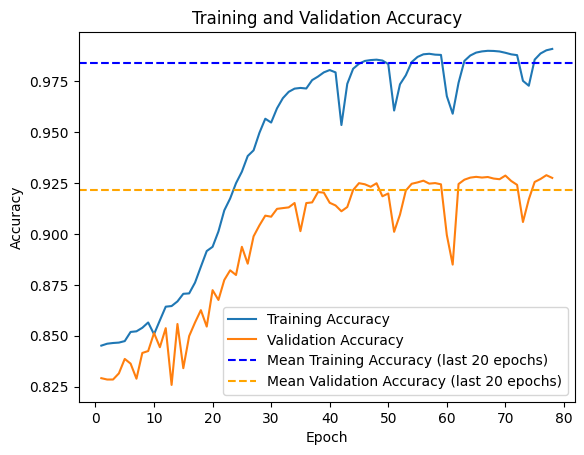

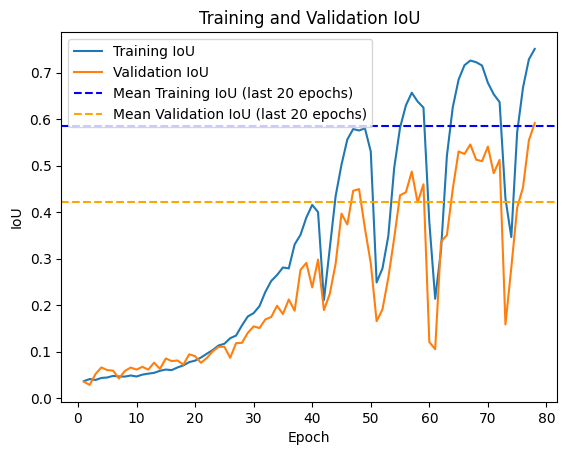

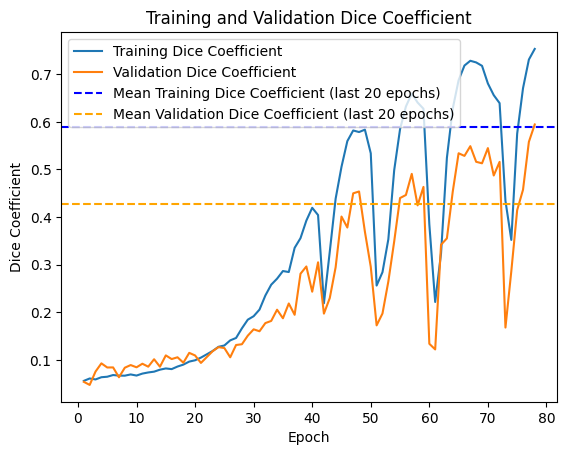

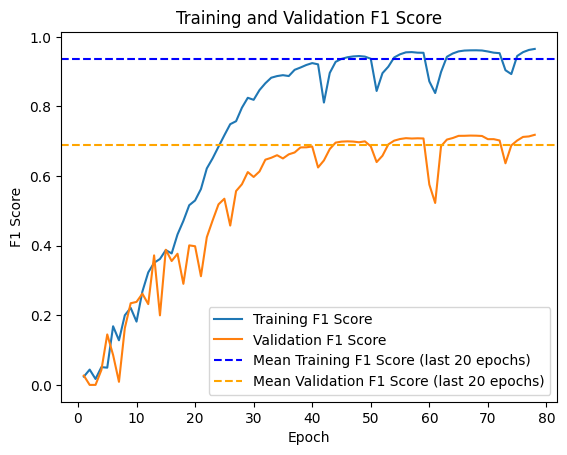

In [ ]:
import json
import pandas as pd
import matplotlib.pyplot as plt

# Load history data from a JSON file
history_filepath = "/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_512_5_Aug_500epc_history_data_0425.json"
with open(history_filepath, "r") as infile:
    history_data = json.load(infile)

# Convert loaded history data to integers for epochs
history_data = {key: [float(value) for value in values] for key, values in history_data.items()}

# Create a DataFrame from the history data
history_df = pd.DataFrame(history_data)

# Display the table of each metric
print(history_df)

# Calculate the mean values for accuracy, IoU, Dice Coefficient, and F1 Score for the last 20 epochs
last_20_epochs_df = history_df.tail(20)
mean_accuracy = last_20_epochs_df["accuracy"].mean()
mean_val_accuracy = last_20_epochs_df["val_accuracy"].mean()
mean_iou = last_20_epochs_df["iou"].mean()
mean_val_iou = last_20_epochs_df["val_iou"].mean()
mean_dice_coef = last_20_epochs_df["dice_coef"].mean()
mean_val_dice_coef = last_20_epochs_df["val_dice_coef"].mean()
mean_f1_score = last_20_epochs_df["f1_score"].mean()
mean_val_f1_score = last_20_epochs_df["val_f1_score"].mean()

# Create a DataFrame to display the mean values as a table
mean_values_df = pd.DataFrame({
    "Metric": ["Training Accuracy", "Validation Accuracy", "Training IoU", "Validation IoU", "Training Dice Coefficient", "Validation Dice Coefficient", "Training F1 Score", "Validation F1 Score"],
    "Mean (last 20 epochs)": [mean_accuracy, mean_val_accuracy, mean_iou, mean_val_iou, mean_dice_coef, mean_val_dice_coef, mean_f1_score, mean_val_f1_score]
})

print("Mean values for the last 20 epochs:")
print(mean_values_df)

# Plot the accuracy of each epoch using the loaded history data
plt.figure()
plt.plot(range(1, len(history_data["accuracy"]) + 1), history_data["accuracy"], label="Training Accuracy")
plt.plot(range(1, len(history_data["val_accuracy"]) + 1), history_data["val_accuracy"], label="Validation Accuracy")
plt.axhline(mean_accuracy, linestyle='--', color='blue', label='Mean Training Accuracy (last 20 epochs)')
plt.axhline(mean_val_accuracy, linestyle='--', color='orange', label='Mean Validation Accuracy (last 20 epochs)')
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend()
plt.title("Training and Validation Accuracy")
plt.show()

# Plot the IoU of each epoch using the loaded history data
plt.figure()
plt.plot(range(1, len(history_data["iou"]) + 1), history_data["iou"], label="Training IoU")
plt.plot(range(1, len(history_data["val_iou"]) + 1), history_data["val_iou"], label="Validation IoU")
plt.axhline(mean_iou, linestyle='--', color='blue', label='Mean Training IoU (last 20 epochs)')
plt.axhline(mean_val_iou, linestyle='--', color='orange', label='Mean Validation IoU (last 20 epochs)')
plt.xlabel("Epoch")
plt.ylabel("IoU")
plt.legend()
plt.title("Training and Validation IoU")
plt.show()

# Plot the Dice Coefficient of each epoch using the loaded history data
plt.figure()
plt.plot(range(1, len(history_data["dice_coef"]) + 1), history_data["dice_coef"], label="Training Dice Coefficient")
plt.plot(range(1, len(history_data["val_dice_coef"]) + 1), history_data["val_dice_coef"], label="Validation Dice Coefficient")
plt.axhline(mean_dice_coef, linestyle='--', color='blue', label='Mean Training Dice Coefficient (last 20 epochs)')
plt.axhline(mean_val_dice_coef, linestyle='--', color='orange', label='Mean Validation Dice Coefficient (last 20 epochs)')
plt.xlabel("Epoch")
plt.ylabel("Dice Coefficient")
plt.legend()
plt.title("Training and Validation Dice Coefficient")
plt.show()

# Plot the F1 Score of each epoch using the loaded history data
plt.figure()
plt.plot(range(1, len(history_data["f1_score"]) + 1), history_data["f1_score"], label="Training F1 Score")
plt.plot(range(1, len(history_data["val_f1_score"]) + 1), history_data["val_f1_score"], label="Validation F1 Score")
plt.axhline(mean_f1_score, linestyle='--', color='blue', label='Mean Training F1 Score (last 20 epochs)')
plt.axhline(mean_val_f1_score, linestyle='--', color='orange', label='Mean Validation F1 Score (last 20 epochs)')
plt.xlabel("Epoch")
plt.ylabel("F1 Score")
plt.legend()
plt.title("Training and Validation F1 Score")
plt.show()



# Model 2 : MobileNetV2

### MobileNetV2 / 512 / Epoch 1000

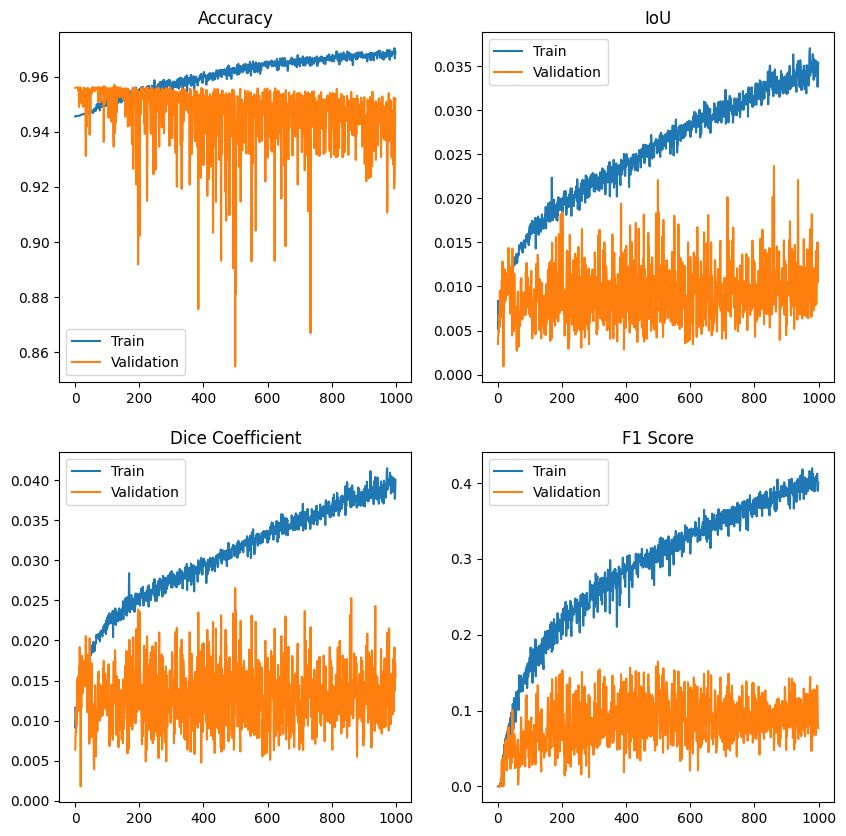

400/400 [==============================] - 14s 35ms/step - loss: 0.0865 - accuracy: 0.9690 - iou: 0.0354 - dice_coef: 0.0401 - f1_score: 0.4003 - val_loss: 0.1969 - val_accuracy: 0.9521 - val_iou: 0.0130 - val_dice_coef: 0.0154 - val_f1_score: 0.0769


150782

In [ ]:
import numpy as np
import tensorflow as tf
from google.colab import files
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate
import matplotlib.pyplot as plt
import json
import gc
from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import EarlyStopping, Callback
from IPython.display import clear_output
from tensorflow.keras.applications import MobileNetV2


input_shape = (512, 512, 3)
early_stopping = EarlyStopping(monitor='val_loss', patience=50, mode='min')

# Load pre-trained MobileNetV2 model
base_model = MobileNetV2(input_shape=input_shape, include_top=False, weights='imagenet')

# Encoder layers
encoder_layer1 = base_model.get_layer('block_1_expand_relu')
encoder_layer2 = base_model.get_layer('block_3_expand_relu')
encoder_layer3 = base_model.get_layer('block_6_expand_relu')
encoder_layer4 = base_model.get_layer('block_13_expand_relu')
encoder_output = base_model.get_layer('out_relu')


def iou(y_true, y_pred):
    intersection = K.sum(K.abs(y_true * y_pred), axis=-1)
    union = K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) - intersection
    return (intersection + K.epsilon()) / (union + K.epsilon())

def dice_coef(y_true, y_pred):
    intersection = K.sum(y_true * y_pred, axis=-1)
    return (2. * intersection + K.epsilon()) / (K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) + K.epsilon())

def f1_score(y_true, y_pred):
    precision = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_pred, 0, 1))) + K.epsilon())
    recall = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_true, 0, 1))) + K.epsilon())
    return 2 * (precision * recall) / (precision + recall + K.epsilon())

class PlotMetricsCallback(Callback):
    def on_train_begin(self, logs=None):
        self.metrics = {"accuracy": [], "val_accuracy": [], "iou": [], "val_iou": [], "dice_coef": [], "val_dice_coef": [], "f1_score": [], "val_f1_score": []}

    def on_epoch_end(self, epoch, logs=None):
        for metric in self.metrics:
            self.metrics[metric].append(logs.get(metric))

        clear_output(wait=True)
        fig, axes = plt.subplots(2, 2, figsize=(10, 10))

        axes[0, 0].plot(self.metrics["accuracy"], label="Train")
        axes[0, 0].plot(self.metrics["val_accuracy"], label="Validation")
        axes[0, 0].set_title("Accuracy")
        axes[0, 0].legend()

        axes[0, 1].plot(self.metrics["iou"], label="Train")
        axes[0, 1].plot(self.metrics["val_iou"], label="Validation")
        axes[0, 1].set_title("IoU")
        axes[0, 1].legend()

        axes[1, 0].plot(self.metrics["dice_coef"], label="Train")
        axes[1, 0].plot(self.metrics["val_dice_coef"], label="Validation")
        axes[1, 0].set_title("Dice Coefficient")
        axes[1, 0].legend()

        axes[1, 1].plot(self.metrics["f1_score"], label="Train")
        axes[1, 1].plot(self.metrics["val_f1_score"], label="Validation")
        axes[1, 1].set_title("F1 Score")
        axes[1, 1].legend()

        plt.show()

plot_metrics_callback = PlotMetricsCallback()

def unet(input_shape):
    # Contracting path using MobileNetV2 encoder layers
    x1 = encoder_layer1.output
    x2 = encoder_layer2.output
    x3 = encoder_layer3.output
    x4 = encoder_layer4.output
    x5 = encoder_output.output

    # Expanding path
    u6 = UpSampling2D((2, 2))(x5)
    u6 = concatenate([u6, x4])
    c6 = Conv2D(128, (3, 3), activation="relu", padding="same")(u6)
    c6 = Conv2D(128, (3, 3), activation="relu", padding="same")(c6)

    u7 = UpSampling2D((2, 2))(c6)
    u7 = concatenate([u7, x3])
    c7 = Conv2D(64, (3, 3), activation="relu", padding="same")(u7)
    c7 = Conv2D(64, (3, 3), activation="relu", padding="same")(c7)

    u8 = UpSampling2D((2, 2))(c7)
    u8 = concatenate([u8, x2])
    c8 = Conv2D(32, (3, 3), activation="relu", padding="same")(u8)
    c8 = Conv2D(32, (3, 3), activation="relu", padding="same")(c8)

    u9 = UpSampling2D((2, 2))(c8)
    u9 = concatenate([u9, x1])
    c9 = Conv2D(16, (3, 3), activation="relu", padding="same")(u9)
    c9 = Conv2D(16, (3, 3), activation="relu", padding="same")(c9)

    u10 = UpSampling2D((2, 2))(c9)
    outputs = Conv2D(1, (1, 1), activation="sigmoid")(u10)

    return Model(inputs=base_model.input, outputs=outputs)

# Create and compile the model
model = unet(input_shape)
model.compile(optimizer="adam", loss="binary_crossentropy", metrics=["accuracy", iou, dice_coef, f1_score])

# Train the model
epochs = 1000
batch_size = 2
history = model.fit(
    train_images_resized, train_labels_resized,
    validation_data=(val_images_resized, val_labels_resized),
    epochs=epochs,
    batch_size=batch_size,
    callbacks=[plot_metrics_callback]
    # callbacks=[early_stopping, plot_metrics_callback]
)

# Save the model to Google Drive
model.save("/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_mobilenet_512_1000epc_0425.h5")

# Save the history file to Google Drive
with open("/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_mobilenet_512_1000epc_history_data_0425.json", "w") as outfile:
    json.dump(history.history, outfile)

gc.collect()



         loss  accuracy       iou  dice_coef  f1_score  val_loss  \
0    0.219414  0.945618  0.008342   0.011603  0.000115  0.171407   
1    0.199113  0.945796  0.005126   0.009036  0.000000  0.175301   
2    0.193154  0.945796  0.005831   0.010143  0.000000  0.204573   
3    0.189974  0.945796  0.006129   0.010597  0.000000  0.175580   
4    0.191547  0.945796  0.006342   0.010884  0.000000  0.196110   
..        ...       ...       ...        ...       ...       ...   
995  0.085989  0.969214  0.034691   0.039382  0.411893  0.218679   
996  0.083384  0.970416  0.034744   0.039181  0.412236  0.207575   
997  0.091362  0.966706  0.032638   0.037686  0.390401  0.206413   
998  0.087443  0.968271  0.033760   0.038490  0.389458  0.207519   
999  0.086467  0.968999  0.035389   0.040076  0.400343  0.196861   

     val_accuracy   val_iou  val_dice_coef  val_f1_score  
0        0.956072  0.003484       0.006367      0.000000  
1        0.956072  0.004587       0.008160      0.000000  
2     

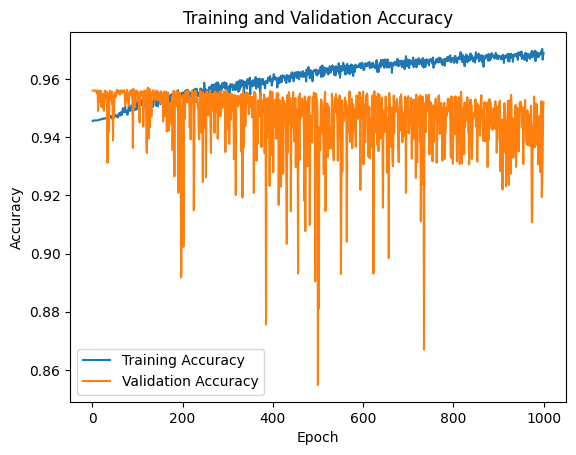

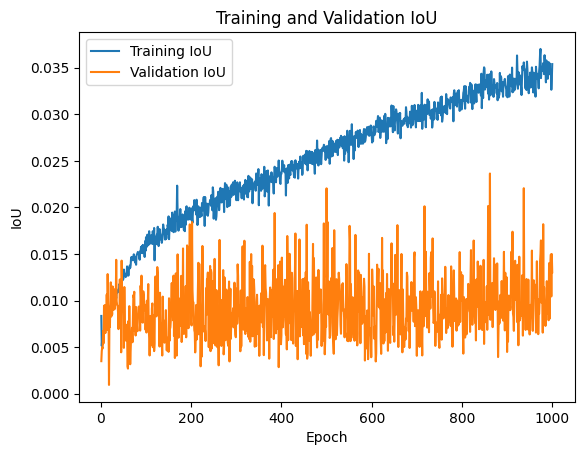

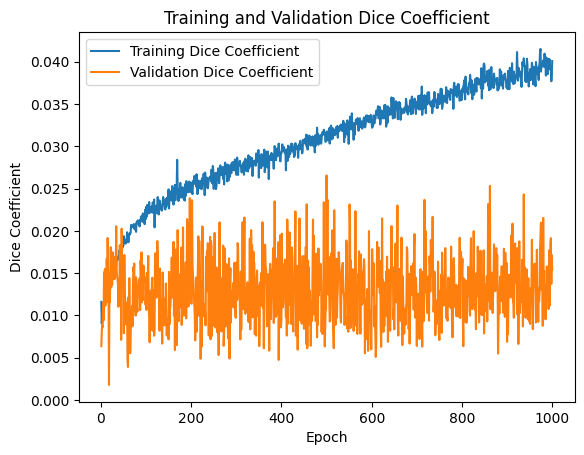

In [ ]:
import json
import pandas as pd
import matplotlib.pyplot as plt

# Load history data from a JSON file
history_filepath = "/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_mobilenet_512_1000epc_history_data_0425.json"
with open(history_filepath, "r") as infile:
    history_data = json.load(infile)

# Convert loaded history data to integers for epochs
history_data = {key: [float(value) for value in values] for key, values in history_data.items()}

# Create a DataFrame from the history data
history_df = pd.DataFrame(history_data)

# Display the table of each metric
print(history_df)

# Plot the accuracy of each epoch using the loaded history data
plt.figure()
plt.plot(range(1, len(history_data["accuracy"]) + 1), history_data["accuracy"], label="Training Accuracy")
plt.plot(range(1, len(history_data["val_accuracy"]) + 1), history_data["val_accuracy"], label="Validation Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend()
plt.title("Training and Validation Accuracy")
plt.show()

# Plot the IoU of each epoch using the loaded history data
plt.figure()
plt.plot(range(1, len(history_data["iou"]) + 1), history_data["iou"], label="Training IoU")
plt.plot(range(1, len(history_data["val_iou"]) + 1), history_data["val_iou"], label="Validation IoU")
plt.xlabel("Epoch")
plt.ylabel("IoU")
plt.legend()
plt.title("Training and Validation IoU")
plt.show()

# Plot the Dice Coefficient of each epoch using the loaded history data
plt.figure()
plt.plot(range(1, len(history_data["dice_coef"]) + 1), history_data["dice_coef"], label="Training Dice Coefficient")
plt.plot(range(1, len(history_data["val_dice_coef"]) + 1), history_data["val_dice_coef"], label="Validation Dice Coefficient")
plt.xlabel("Epoch")
plt.ylabel("Dice Coefficient")
plt.legend()
plt.title("Training and Validation Dice Coefficient")
plt.show()





### MobileNetV2 / 512 / Epoch 500 / 5% / Aug

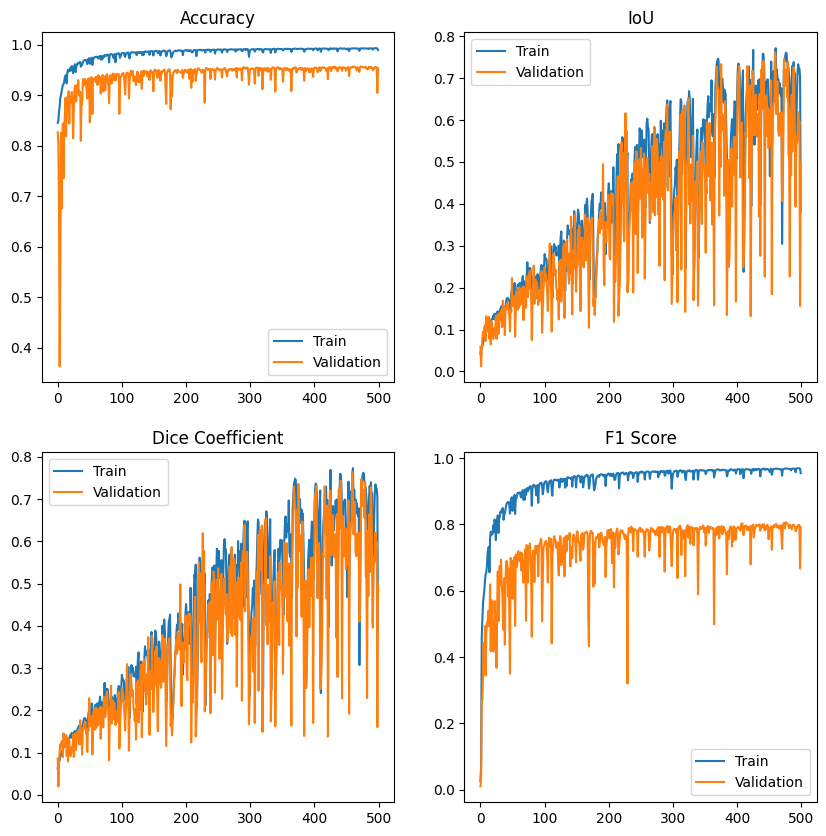

564/564 [==============================] - 21s 37ms/step - loss: 0.0267 - accuracy: 0.9891 - iou: 0.3810 - dice_coef: 0.3833 - f1_score: 0.9545 - val_loss: 0.3492 - val_accuracy: 0.9525 - val_iou: 0.4974 - val_dice_coef: 0.4994 - val_f1_score: 0.7919


94523

In [ ]:
import numpy as np
import tensorflow as tf
from google.colab import files
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate
import matplotlib.pyplot as plt
import json
import gc
from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import EarlyStopping, Callback
from IPython.display import clear_output
from tensorflow.keras.applications import MobileNetV2


input_shape = (512, 512, 3)
early_stopping = EarlyStopping(monitor='val_loss', patience=20, mode='min')

# Load pre-trained MobileNetV2 model
base_model = MobileNetV2(input_shape=input_shape, include_top=False, weights='imagenet')

# Encoder layers
encoder_layer1 = base_model.get_layer('block_1_expand_relu')
encoder_layer2 = base_model.get_layer('block_3_expand_relu')
encoder_layer3 = base_model.get_layer('block_6_expand_relu')
encoder_layer4 = base_model.get_layer('block_13_expand_relu')
encoder_output = base_model.get_layer('out_relu')


def iou(y_true, y_pred):
    intersection = K.sum(K.abs(y_true * y_pred), axis=-1)
    union = K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) - intersection
    return (intersection + K.epsilon()) / (union + K.epsilon())

def dice_coef(y_true, y_pred):
    intersection = K.sum(y_true * y_pred, axis=-1)
    return (2. * intersection + K.epsilon()) / (K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) + K.epsilon())

def f1_score(y_true, y_pred):
    precision = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_pred, 0, 1))) + K.epsilon())
    recall = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_true, 0, 1))) + K.epsilon())
    return 2 * (precision * recall) / (precision + recall + K.epsilon())

class PlotMetricsCallback(Callback):
    def on_train_begin(self, logs=None):
        self.metrics = {"accuracy": [], "val_accuracy": [], "iou": [], "val_iou": [], "dice_coef": [], "val_dice_coef": [], "f1_score": [], "val_f1_score": []}

    def on_epoch_end(self, epoch, logs=None):
        for metric in self.metrics:
            self.metrics[metric].append(logs.get(metric))

        clear_output(wait=True)
        fig, axes = plt.subplots(2, 2, figsize=(10, 10))

        axes[0, 0].plot(self.metrics["accuracy"], label="Train")
        axes[0, 0].plot(self.metrics["val_accuracy"], label="Validation")
        axes[0, 0].set_title("Accuracy")
        axes[0, 0].legend()

        axes[0, 1].plot(self.metrics["iou"], label="Train")
        axes[0, 1].plot(self.metrics["val_iou"], label="Validation")
        axes[0, 1].set_title("IoU")
        axes[0, 1].legend()

        axes[1, 0].plot(self.metrics["dice_coef"], label="Train")
        axes[1, 0].plot(self.metrics["val_dice_coef"], label="Validation")
        axes[1, 0].set_title("Dice Coefficient")
        axes[1, 0].legend()

        axes[1, 1].plot(self.metrics["f1_score"], label="Train")
        axes[1, 1].plot(self.metrics["val_f1_score"], label="Validation")
        axes[1, 1].set_title("F1 Score")
        axes[1, 1].legend()

        plt.show()

plot_metrics_callback = PlotMetricsCallback()

def unet(input_shape):
    # Contracting path using MobileNetV2 encoder layers
    x1 = encoder_layer1.output
    x2 = encoder_layer2.output
    x3 = encoder_layer3.output
    x4 = encoder_layer4.output
    x5 = encoder_output.output

    # Expanding path
    u6 = UpSampling2D((2, 2))(x5)
    u6 = concatenate([u6, x4])
    c6 = Conv2D(128, (3, 3), activation="relu", padding="same")(u6)
    c6 = Conv2D(128, (3, 3), activation="relu", padding="same")(c6)

    u7 = UpSampling2D((2, 2))(c6)
    u7 = concatenate([u7, x3])
    c7 = Conv2D(64, (3, 3), activation="relu", padding="same")(u7)
    c7 = Conv2D(64, (3, 3), activation="relu", padding="same")(c7)

    u8 = UpSampling2D((2, 2))(c7)
    u8 = concatenate([u8, x2])
    c8 = Conv2D(32, (3, 3), activation="relu", padding="same")(u8)
    c8 = Conv2D(32, (3, 3), activation="relu", padding="same")(c8)

    u9 = UpSampling2D((2, 2))(c8)
    u9 = concatenate([u9, x1])
    c9 = Conv2D(16, (3, 3), activation="relu", padding="same")(u9)
    c9 = Conv2D(16, (3, 3), activation="relu", padding="same")(c9)

    u10 = UpSampling2D((2, 2))(c9)
    outputs = Conv2D(1, (1, 1), activation="sigmoid")(u10)

    return Model(inputs=base_model.input, outputs=outputs)

# Create and compile the model
model = unet(input_shape)
model.compile(optimizer="adam", loss="binary_crossentropy", metrics=["accuracy", iou, dice_coef, f1_score])

# Train the model
epochs = 500
batch_size = 2
history = model.fit(
    train_images_resized, train_labels_resized,
    validation_data=(val_images_resized, val_labels_resized),
    epochs=epochs,
    batch_size=batch_size,
    # callbacks=[plot_metrics_callback]
    callbacks=[early_stopping, plot_metrics_callback]
)

# Save the model to Google Drive
model.save("/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_mobilenet_512_5_Aug_500epc_0425.h5")

# Save the history file to Google Drive
with open("/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_mobilenet_512_5_Aug_500epc_history_data_0425.json", "w") as outfile:
    json.dump(history.history, outfile)

gc.collect()



### predict

36/36 [==============================] - 11s 67ms/step
Area of Predicted Mask 1: 30324.0
Area of Actual Label 1: 118.29803921568627
Area of Predicted Mask 2: 71512.0
Area of Actual Label 2: 280.0156862745098
Area of Predicted Mask 3: 32000.0
Area of Actual Label 3: 123.54117647058824
Area of Predicted Mask 4: 24824.0
Area of Actual Label 4: 98.05882352941177
Area of Predicted Mask 5: 42128.0
Area of Actual Label 5: 164.44313725490196
Area of Predicted Mask 6: 39876.0
Area of Actual Label 6: 149.90588235294118
Area of Predicted Mask 7: 131648.0
Area of Actual Label 7: 517.4470588235295
Area of Predicted Mask 8: 28372.0
Area of Actual Label 8: 109.27450980392157
Area of Predicted Mask 9: 72144.0
Area of Actual Label 9: 250.16862745098038
Area of Predicted Mask 10: 14556.0
Area of Actual Label 10: 56.29019607843137


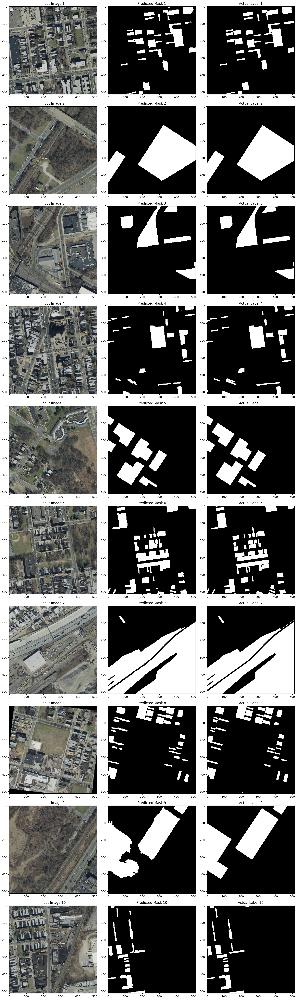

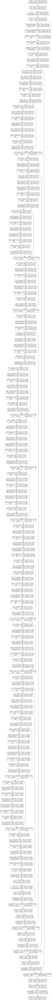

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt
import random

# Define the custom metric functions
def iou(y_true, y_pred):
    intersection = K.sum(K.abs(y_true * y_pred), axis=-1)
    union = K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) - intersection
    return (intersection + K.epsilon()) / (union + K.epsilon())

def dice_coef(y_true, y_pred):
    intersection = K.sum(y_true * y_pred, axis=-1)
    return (2. * intersection + K.epsilon()) / (K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) + K.epsilon())

def f1_score(y_true, y_pred):
    precision = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_pred, 0, 1))) + K.epsilon())
    recall = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_true, 0, 1))) + K.epsilon())
    return 2 * (precision * recall) / (precision + recall + K.epsilon())


# Load the saved model with custom metrics
model_path = "/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_mobilenet_512_5_Aug_500epc_0425.h5"
model = load_model(model_path, custom_objects={'iou': iou, 'dice_coef': dice_coef, 'f1_score': f1_score})

# Predict the masks for the entire train data set
predictions = model.predict(train_images_resized)

# Process the predictions
threshold = 0.5
binary_predictions = (predictions > threshold).astype(np.uint8) * 255

# Choose 10 random indices from the train data set
num_samples = 10
random_indices = random.sample(range(len(train_images_resized)), num_samples)

plt.figure(figsize=(15, 50))

# Display the input images, predicted masks, and actual labels for the chosen indices
for i, index in enumerate(random_indices):
    plt.subplot(num_samples, 3, i * 3 + 1)
    plt.imshow(train_images_resized[index])
    plt.title(f"Input Image {i + 1}")

    plt.subplot(num_samples, 3, i * 3 + 2)
    plt.imshow(binary_predictions[index].squeeze(), cmap="gray")
    plt.title(f"Predicted Mask {i + 1}")

    plt.subplot(num_samples, 3, i * 3 + 3)
    plt.imshow(train_labels_resized[index].squeeze(), cmap="gray")
    plt.title(f"Actual Label {i + 1}")

    # Calculate the area of the predicted and actual labels
    predicted_area = np.sum(binary_predictions[index]) / 255
    actual_area = np.sum(train_labels_resized[index]) / 255

    print(f"Area of Predicted Mask {i + 1}: {predicted_area}")
    print(f"Area of Actual Label {i + 1}: {actual_area}")

plt.tight_layout()
plt.show()


from tensorflow.keras.utils import plot_model

# Assuming 'model' is the name of your model object
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)


### History

         loss  accuracy       iou  dice_coef  f1_score  val_loss  \
0    0.375663  0.844882  0.042239   0.062007  0.026178  0.529832   
1    0.316399  0.850144  0.053111   0.074794  0.071512  0.689151   
2    0.298147  0.868036  0.056647   0.078725  0.457469  0.573154   
3    0.279986  0.876264  0.060485   0.082717  0.516031  0.660230   
4    0.250842  0.893844  0.067717   0.089312  0.562240  0.616324   
..        ...       ...       ...        ...       ...       ...   
495  0.016392  0.992728  0.733037   0.734575  0.969590  0.351293   
496  0.016540  0.992669  0.724141   0.725692  0.969278  0.351652   
497  0.016638  0.992632  0.722888   0.724446  0.969058  0.354909   
498  0.017748  0.992281  0.703724   0.705343  0.968018  0.454774   
499  0.026699  0.989070  0.381032   0.383344  0.954526  0.349185   

     val_accuracy   val_iou  val_dice_coef  val_f1_score  
0        0.826197  0.058887       0.085662      0.009992  
1        0.800366  0.012014       0.019876      0.036868  
2     

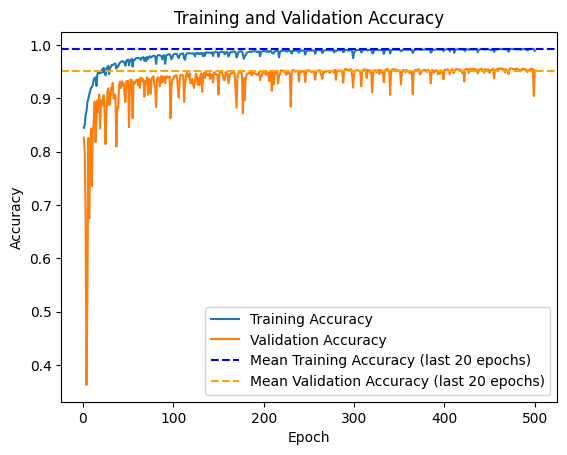

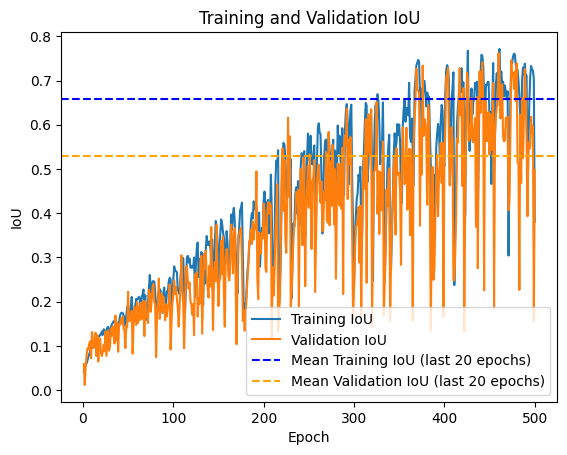

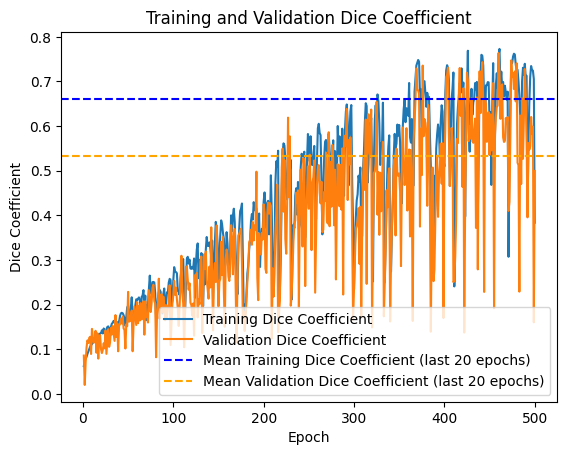

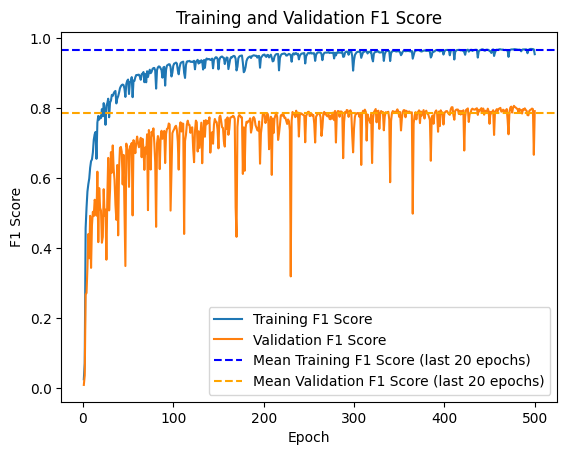

In [ ]:
import json
import pandas as pd
import matplotlib.pyplot as plt

# Load history data from a JSON file
history_filepath = "/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_mobilenet_512_5_Aug_500epc_history_data_0425.json"
with open(history_filepath, "r") as infile:
    history_data = json.load(infile)

# Convert loaded history data to integers for epochs
history_data = {key: [float(value) for value in values] for key, values in history_data.items()}

# Create a DataFrame from the history data
history_df = pd.DataFrame(history_data)

# Display the table of each metric
print(history_df)

# Calculate the mean values for accuracy, IoU, Dice Coefficient, and F1 Score for the last 20 epochs
last_20_epochs_df = history_df.tail(20)
mean_accuracy = last_20_epochs_df["accuracy"].mean()
mean_val_accuracy = last_20_epochs_df["val_accuracy"].mean()
mean_iou = last_20_epochs_df["iou"].mean()
mean_val_iou = last_20_epochs_df["val_iou"].mean()
mean_dice_coef = last_20_epochs_df["dice_coef"].mean()
mean_val_dice_coef = last_20_epochs_df["val_dice_coef"].mean()
mean_f1_score = last_20_epochs_df["f1_score"].mean()
mean_val_f1_score = last_20_epochs_df["val_f1_score"].mean()

# Create a DataFrame to display the mean values as a table
mean_values_df = pd.DataFrame({
    "Metric": ["Training Accuracy", "Validation Accuracy", "Training IoU", "Validation IoU", "Training Dice Coefficient", "Validation Dice Coefficient", "Training F1 Score", "Validation F1 Score"],
    "Mean (last 20 epochs)": [mean_accuracy, mean_val_accuracy, mean_iou, mean_val_iou, mean_dice_coef, mean_val_dice_coef, mean_f1_score, mean_val_f1_score]
})

print("Mean values for the last 20 epochs:")
print(mean_values_df)

# Plot the accuracy of each epoch using the loaded history data
plt.figure()
plt.plot(range(1, len(history_data["accuracy"]) + 1), history_data["accuracy"], label="Training Accuracy")
plt.plot(range(1, len(history_data["val_accuracy"]) + 1), history_data["val_accuracy"], label="Validation Accuracy")
plt.axhline(mean_accuracy, linestyle='--', color='blue', label='Mean Training Accuracy (last 20 epochs)')
plt.axhline(mean_val_accuracy, linestyle='--', color='orange', label='Mean Validation Accuracy (last 20 epochs)')
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend()
plt.title("Training and Validation Accuracy")
plt.show()

# Plot the IoU of each epoch using the loaded history data
plt.figure()
plt.plot(range(1, len(history_data["iou"]) + 1), history_data["iou"], label="Training IoU")
plt.plot(range(1, len(history_data["val_iou"]) + 1), history_data["val_iou"], label="Validation IoU")
plt.axhline(mean_iou, linestyle='--', color='blue', label='Mean Training IoU (last 20 epochs)')
plt.axhline(mean_val_iou, linestyle='--', color='orange', label='Mean Validation IoU (last 20 epochs)')
plt.xlabel("Epoch")
plt.ylabel("IoU")
plt.legend()
plt.title("Training and Validation IoU")
plt.show()

# Plot the Dice Coefficient of each epoch using the loaded history data
plt.figure()
plt.plot(range(1, len(history_data["dice_coef"]) + 1), history_data["dice_coef"], label="Training Dice Coefficient")
plt.plot(range(1, len(history_data["val_dice_coef"]) + 1), history_data["val_dice_coef"], label="Validation Dice Coefficient")
plt.axhline(mean_dice_coef, linestyle='--', color='blue', label='Mean Training Dice Coefficient (last 20 epochs)')
plt.axhline(mean_val_dice_coef, linestyle='--', color='orange', label='Mean Validation Dice Coefficient (last 20 epochs)')
plt.xlabel("Epoch")
plt.ylabel("Dice Coefficient")
plt.legend()
plt.title("Training and Validation Dice Coefficient")
plt.show()

# Plot the F1 Score of each epoch using the loaded history data
plt.figure()
plt.plot(range(1, len(history_data["f1_score"]) + 1), history_data["f1_score"], label="Training F1 Score")
plt.plot(range(1, len(history_data["val_f1_score"]) + 1), history_data["val_f1_score"], label="Validation F1 Score")
plt.axhline(mean_f1_score, linestyle='--', color='blue', label='Mean Training F1 Score (last 20 epochs)')
plt.axhline(mean_val_f1_score, linestyle='--', color='orange', label='Mean Validation F1 Score (last 20 epochs)')
plt.xlabel("Epoch")
plt.ylabel("F1 Score")
plt.legend()
plt.title("Training and Validation F1 Score")
plt.show()



# Model 3 : efficientnet

In [ ]:
!pip install -U efficientnet

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 7.5 MB/s eta 0:00:00


### efficientnet / 512 / Epoch 1000

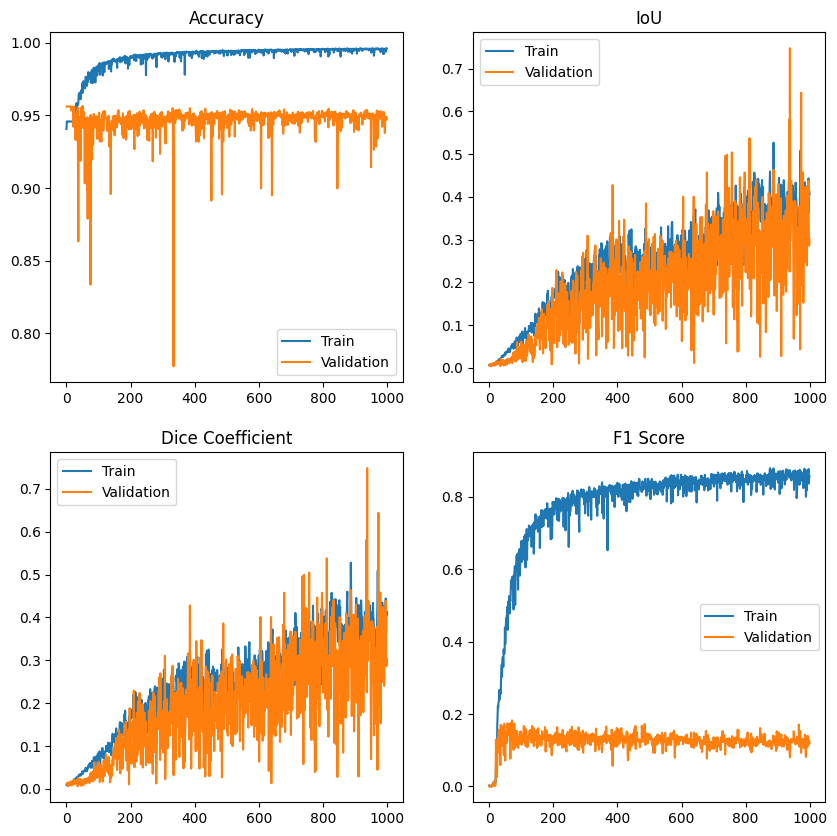

400/400 [==============================] - 19s 49ms/step - loss: 0.0098 - accuracy: 0.9960 - iou: 0.4062 - dice_coef: 0.4071 - f1_score: 0.8569 - val_loss: 0.4409 - val_accuracy: 0.9487 - val_iou: 0.3016 - val_dice_coef: 0.3023 - val_f1_score: 0.1191


173375

In [ ]:
import numpy as np
import tensorflow as tf
from google.colab import files
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate
import matplotlib.pyplot as plt
import json
import gc
from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import EarlyStopping, Callback
from IPython.display import clear_output
import efficientnet.keras as efn  # Import EfficientNet from the installed package

input_shape = (512, 512, 3)
early_stopping = EarlyStopping(monitor='val_loss', patience=50, mode='min')

# Load pre-trained EfficientNetB0 model
base_model = efn.EfficientNetB0(input_shape=input_shape, include_top=False, weights='imagenet')

# Encoder layers
encoder_layer1 = base_model.get_layer('block2a_expand_activation')  # Change the layer names to match the EfficientNet layers
encoder_layer2 = base_model.get_layer('block3a_expand_activation')
encoder_layer3 = base_model.get_layer('block4a_expand_activation')
encoder_layer4 = base_model.get_layer('block6a_expand_activation')
encoder_output = base_model.get_layer('top_activation')


def iou(y_true, y_pred):
    intersection = K.sum(K.abs(y_true * y_pred), axis=-1)
    union = K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) - intersection
    return (intersection + K.epsilon()) / (union + K.epsilon())

def dice_coef(y_true, y_pred):
    intersection = K.sum(y_true * y_pred, axis=-1)
    return (2. * intersection + K.epsilon()) / (K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) + K.epsilon())

def f1_score(y_true, y_pred):
    precision = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_pred, 0, 1))) + K.epsilon())
    recall = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_true, 0, 1))) + K.epsilon())
    return 2 * (precision * recall) / (precision + recall + K.epsilon())

class PlotMetricsCallback(Callback):
    def on_train_begin(self, logs=None):
        self.metrics = {"accuracy": [], "val_accuracy": [], "iou": [], "val_iou": [], "dice_coef": [], "val_dice_coef": [], "f1_score": [], "val_f1_score": []}

    def on_epoch_end(self, epoch, logs=None):
        for metric in self.metrics:
            self.metrics[metric].append(logs.get(metric))

        clear_output(wait=True)
        fig, axes = plt.subplots(2, 2, figsize=(10, 10))

        axes[0, 0].plot(self.metrics["accuracy"], label="Train")
        axes[0, 0].plot(self.metrics["val_accuracy"], label="Validation")
        axes[0, 0].set_title("Accuracy")
        axes[0, 0].legend()

        axes[0, 1].plot(self.metrics["iou"], label="Train")
        axes[0, 1].plot(self.metrics["val_iou"], label="Validation")
        axes[0, 1].set_title("IoU")
        axes[0, 1].legend()

        axes[1, 0].plot(self.metrics["dice_coef"], label="Train")
        axes[1, 0].plot(self.metrics["val_dice_coef"], label="Validation")
        axes[1, 0].set_title("Dice Coefficient")
        axes[1, 0].legend()

        axes[1, 1].plot(self.metrics["f1_score"], label="Train")
        axes[1, 1].plot(self.metrics["val_f1_score"], label="Validation")
        axes[1, 1].set_title("F1 Score")
        axes[1, 1].legend()

        plt.show()

plot_metrics_callback = PlotMetricsCallback()

def unet(input_shape):
    # Contracting path using MobileNetV2 encoder layers
    x1 = encoder_layer1.output
    x2 = encoder_layer2.output
    x3 = encoder_layer3.output
    x4 = encoder_layer4.output
    x5 = encoder_output.output

    # Expanding path
    u6 = UpSampling2D((2, 2))(x5)
    u6 = concatenate([u6, x4])
    c6 = Conv2D(128, (3, 3), activation="relu", padding="same")(u6)
    c6 = Conv2D(128, (3, 3), activation="relu", padding="same")(c6)

    u7 = UpSampling2D((2, 2))(c6)
    u7 = concatenate([u7, x3])
    c7 = Conv2D(64, (3, 3), activation="relu", padding="same")(u7)
    c7 = Conv2D(64, (3, 3), activation="relu", padding="same")(c7)

    u8 = UpSampling2D((2, 2))(c7)
    u8 = concatenate([u8, x2])
    c8 = Conv2D(32, (3, 3), activation="relu", padding="same")(u8)
    c8 = Conv2D(32, (3, 3), activation="relu", padding="same")(c8)

    u9 = UpSampling2D((2, 2))(c8)
    u9 = concatenate([u9, x1])
    c9 = Conv2D(16, (3, 3), activation="relu", padding="same")(u9)
    c9 = Conv2D(16, (3, 3), activation="relu", padding="same")(c9)

    u10 = UpSampling2D((2, 2))(c9)
    outputs = Conv2D(1, (1, 1), activation="sigmoid")(u10)

    return Model(inputs=base_model.input, outputs=outputs)

# Create and compile the model
model = unet(input_shape)
model.compile(optimizer="adam", loss="binary_crossentropy", metrics=["accuracy", iou, dice_coef, f1_score])

# Train the model
epochs = 1000
batch_size = 2
history = model.fit(
    train_images_resized, train_labels_resized,
    validation_data=(val_images_resized, val_labels_resized),
    epochs=epochs,
    batch_size=batch_size,
    callbacks=[plot_metrics_callback]
    # callbacks=[early_stopping, plot_metrics_callback]
)

# Save the model to Google Drive
model.save("/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_efficientnet_512_1000epc_0425.h5")

# Save the history file to Google Drive
with open("/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_efficientnet_512_1000epc_history_data_0425.json", "w") as outfile:
    json.dump(history.history, outfile)

gc.collect()



In [ ]:
import json
import pandas as pd
import matplotlib.pyplot as plt

# Load history data from a JSON file
history_filepath = "/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_efficientnet_512_1000epc_history_data_0425.json"
with open(history_filepath, "r") as infile:
    history_data = json.load(infile)

# Convert loaded history data to integers for epochs
history_data = {key: [float(value) for value in values] for key, values in history_data.items()}

# Create a DataFrame from the history data
history_df = pd.DataFrame(history_data)

# Display the table of each metric
print(history_df)

# Plot the accuracy of each epoch using the loaded history data
plt.figure()
plt.plot(range(1, len(history_data["accuracy"]) + 1), history_data["accuracy"], label="Training Accuracy")
plt.plot(range(1, len(history_data["val_accuracy"]) + 1), history_data["val_accuracy"], label="Validation Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend()
plt.title("Training and Validation Accuracy")
plt.show()

# Plot the IoU of each epoch using the loaded history data
plt.figure()
plt.plot(range(1, len(history_data["iou"]) + 1), history_data["iou"], label="Training IoU")
plt.plot(range(1, len(history_data["val_iou"]) + 1), history_data["val_iou"], label="Validation IoU")
plt.xlabel("Epoch")
plt.ylabel("IoU")
plt.legend()
plt.title("Training and Validation IoU")
plt.show()

# Plot the Dice Coefficient of each epoch using the loaded history data
plt.figure()
plt.plot(range(1, len(history_data["dice_coef"]) + 1), history_data["dice_coef"], label="Training Dice Coefficient")
plt.plot(range(1, len(history_data["val_dice_coef"]) + 1), history_data["val_dice_coef"], label="Validation Dice Coefficient")
plt.xlabel("Epoch")
plt.ylabel("Dice Coefficient")
plt.legend()
plt.title("Training and Validation Dice Coefficient")
plt.show()



FileNotFoundError: ignored

### efficientnet / 512 / Epoch 500 / 5% / Aug

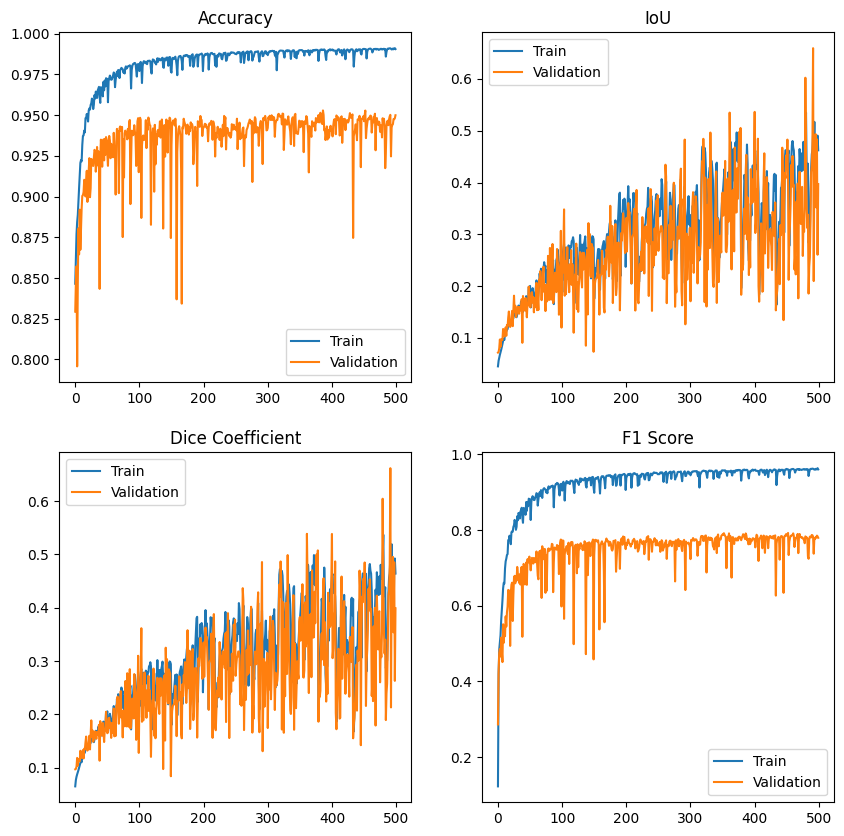

564/564 [==============================] - 29s 51ms/step - loss: 0.0222 - accuracy: 0.9906 - iou: 0.4622 - dice_coef: 0.4642 - f1_score: 0.9603 - val_loss: 0.8341 - val_accuracy: 0.9499 - val_iou: 0.3969 - val_dice_coef: 0.3990 - val_f1_score: 0.7796


62697

In [ ]:
import numpy as np
import tensorflow as tf
from google.colab import files
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate
import matplotlib.pyplot as plt
import json
import gc
from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import EarlyStopping, Callback
from IPython.display import clear_output
import efficientnet.keras as efn  # Import EfficientNet from the installed package

input_shape = (512, 512, 3)
early_stopping = EarlyStopping(monitor='val_loss', patience=20, mode='min')

# Load pre-trained EfficientNetB0 model
base_model = efn.EfficientNetB0(input_shape=input_shape, include_top=False, weights='imagenet')

# Encoder layers
encoder_layer1 = base_model.get_layer('block2a_expand_activation')  # Change the layer names to match the EfficientNet layers
encoder_layer2 = base_model.get_layer('block3a_expand_activation')
encoder_layer3 = base_model.get_layer('block4a_expand_activation')
encoder_layer4 = base_model.get_layer('block6a_expand_activation')
encoder_output = base_model.get_layer('top_activation')


def iou(y_true, y_pred):
    intersection = K.sum(K.abs(y_true * y_pred), axis=-1)
    union = K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) - intersection
    return (intersection + K.epsilon()) / (union + K.epsilon())

def dice_coef(y_true, y_pred):
    intersection = K.sum(y_true * y_pred, axis=-1)
    return (2. * intersection + K.epsilon()) / (K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) + K.epsilon())

def f1_score(y_true, y_pred):
    precision = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_pred, 0, 1))) + K.epsilon())
    recall = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_true, 0, 1))) + K.epsilon())
    return 2 * (precision * recall) / (precision + recall + K.epsilon())

class PlotMetricsCallback(Callback):
    def on_train_begin(self, logs=None):
        self.metrics = {"accuracy": [], "val_accuracy": [], "iou": [], "val_iou": [], "dice_coef": [], "val_dice_coef": [], "f1_score": [], "val_f1_score": []}

    def on_epoch_end(self, epoch, logs=None):
        for metric in self.metrics:
            self.metrics[metric].append(logs.get(metric))

        clear_output(wait=True)
        fig, axes = plt.subplots(2, 2, figsize=(10, 10))

        axes[0, 0].plot(self.metrics["accuracy"], label="Train")
        axes[0, 0].plot(self.metrics["val_accuracy"], label="Validation")
        axes[0, 0].set_title("Accuracy")
        axes[0, 0].legend()

        axes[0, 1].plot(self.metrics["iou"], label="Train")
        axes[0, 1].plot(self.metrics["val_iou"], label="Validation")
        axes[0, 1].set_title("IoU")
        axes[0, 1].legend()

        axes[1, 0].plot(self.metrics["dice_coef"], label="Train")
        axes[1, 0].plot(self.metrics["val_dice_coef"], label="Validation")
        axes[1, 0].set_title("Dice Coefficient")
        axes[1, 0].legend()

        axes[1, 1].plot(self.metrics["f1_score"], label="Train")
        axes[1, 1].plot(self.metrics["val_f1_score"], label="Validation")
        axes[1, 1].set_title("F1 Score")
        axes[1, 1].legend()

        plt.show()

plot_metrics_callback = PlotMetricsCallback()

def unet(input_shape):
    # Contracting path using MobileNetV2 encoder layers
    x1 = encoder_layer1.output
    x2 = encoder_layer2.output
    x3 = encoder_layer3.output
    x4 = encoder_layer4.output
    x5 = encoder_output.output

    # Expanding path
    u6 = UpSampling2D((2, 2))(x5)
    u6 = concatenate([u6, x4])
    c6 = Conv2D(128, (3, 3), activation="relu", padding="same")(u6)
    c6 = Conv2D(128, (3, 3), activation="relu", padding="same")(c6)

    u7 = UpSampling2D((2, 2))(c6)
    u7 = concatenate([u7, x3])
    c7 = Conv2D(64, (3, 3), activation="relu", padding="same")(u7)
    c7 = Conv2D(64, (3, 3), activation="relu", padding="same")(c7)

    u8 = UpSampling2D((2, 2))(c7)
    u8 = concatenate([u8, x2])
    c8 = Conv2D(32, (3, 3), activation="relu", padding="same")(u8)
    c8 = Conv2D(32, (3, 3), activation="relu", padding="same")(c8)

    u9 = UpSampling2D((2, 2))(c8)
    u9 = concatenate([u9, x1])
    c9 = Conv2D(16, (3, 3), activation="relu", padding="same")(u9)
    c9 = Conv2D(16, (3, 3), activation="relu", padding="same")(c9)

    u10 = UpSampling2D((2, 2))(c9)
    outputs = Conv2D(1, (1, 1), activation="sigmoid")(u10)

    return Model(inputs=base_model.input, outputs=outputs)

# Create and compile the model
model = unet(input_shape)
model.compile(optimizer="adam", loss="binary_crossentropy", metrics=["accuracy", iou, dice_coef, f1_score])

# Train the model
epochs = 500
batch_size = 2
history = model.fit(
    train_images_resized, train_labels_resized,
    validation_data=(val_images_resized, val_labels_resized),
    epochs=epochs,
    batch_size=batch_size,
    callbacks=[plot_metrics_callback]
    # callbacks=[early_stopping, plot_metrics_callback]
)

# Save the model to Google Drive
model.save("/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_efficientnet_512_5_Aug_500epc_0425.h5")

# Save the history file to Google Drive
with open("/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_efficientnet_512_5_Aug_500epc_history_data_0425.json", "w") as outfile:
    json.dump(history.history, outfile)

gc.collect()



### predict

36/36 [==============================] - 18s 399ms/step


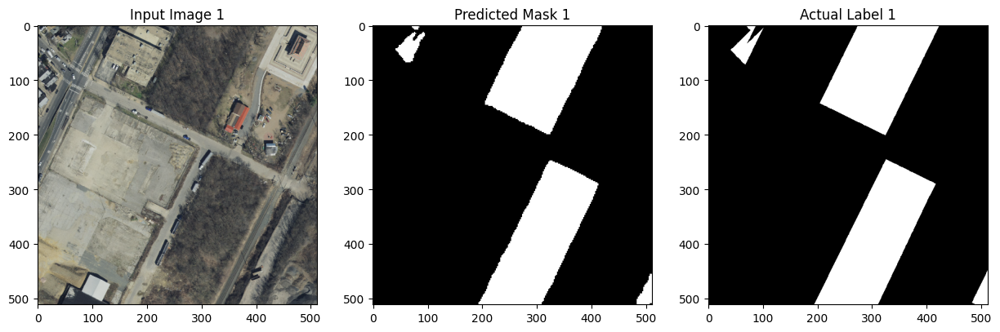

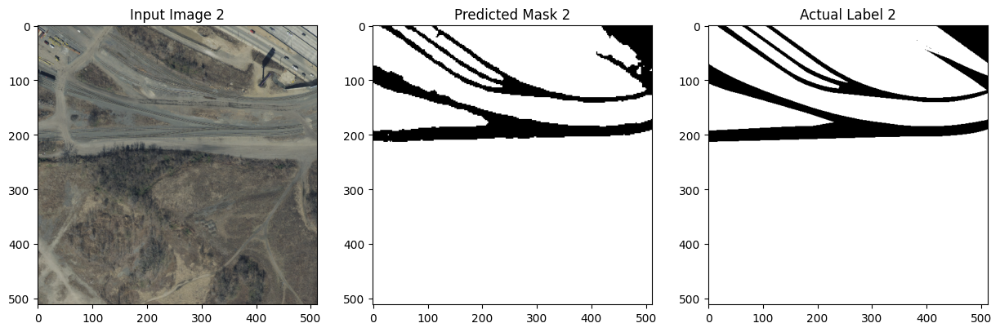

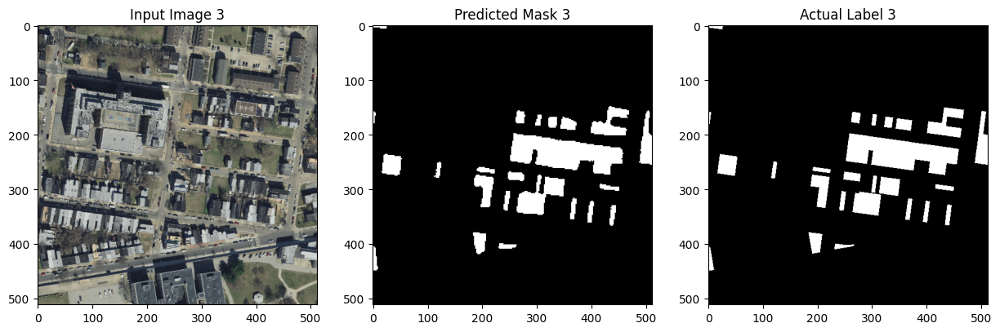

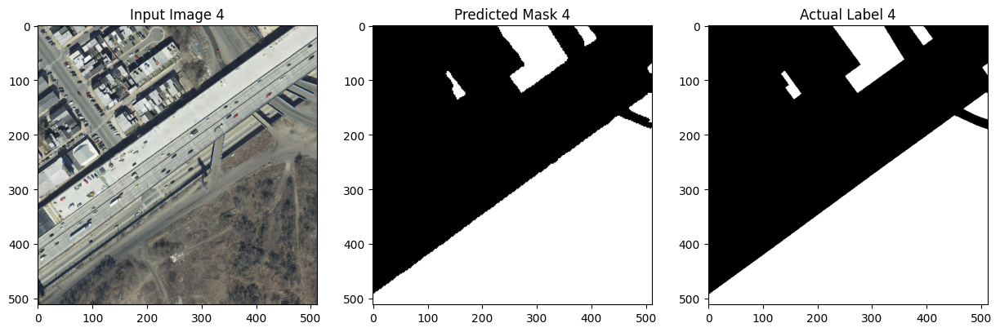

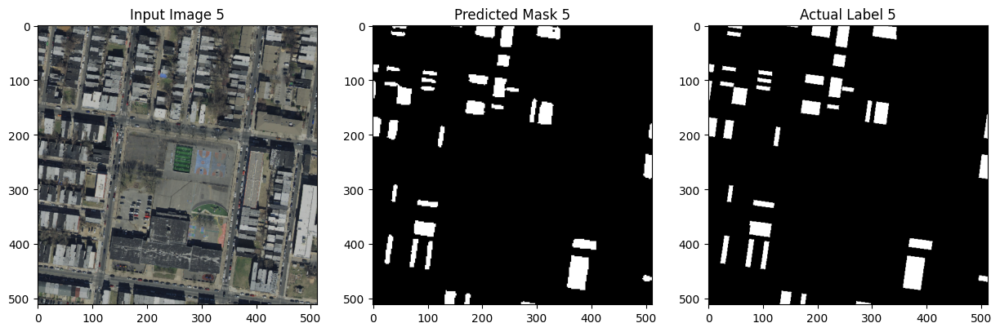

...

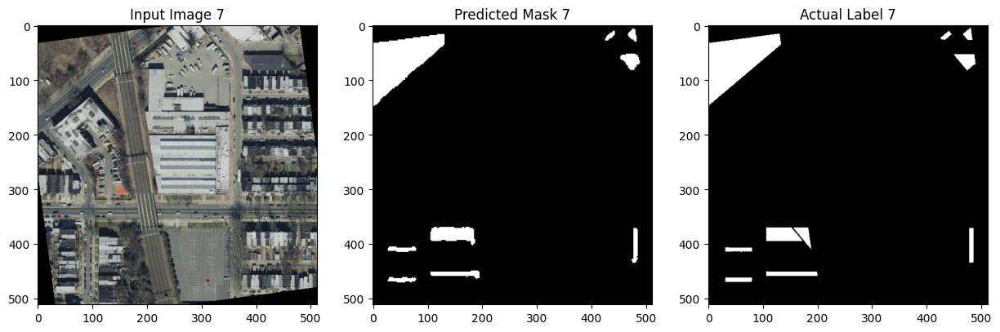

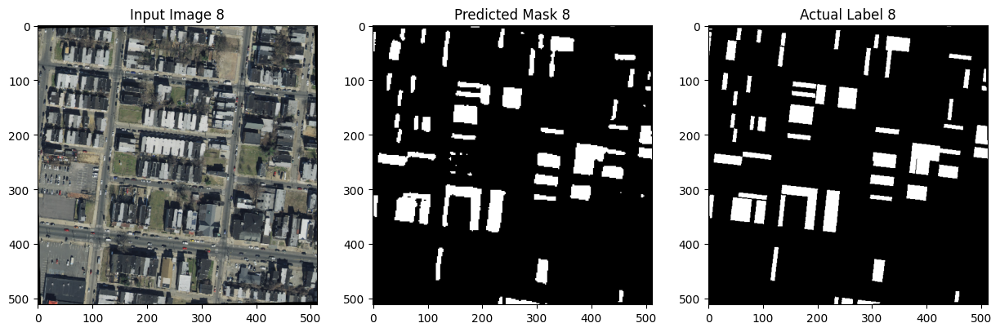

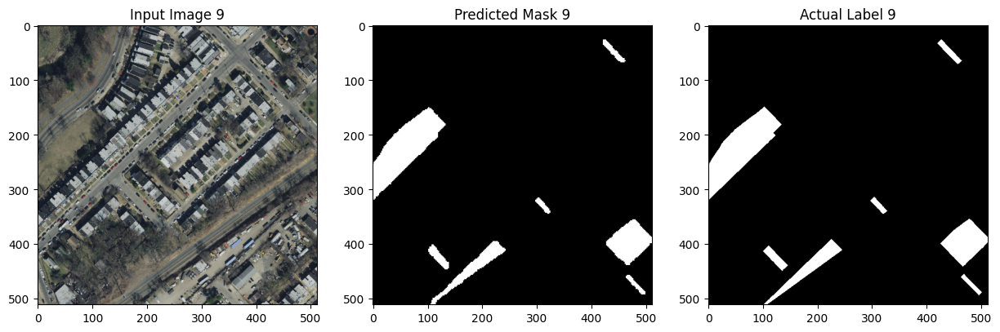

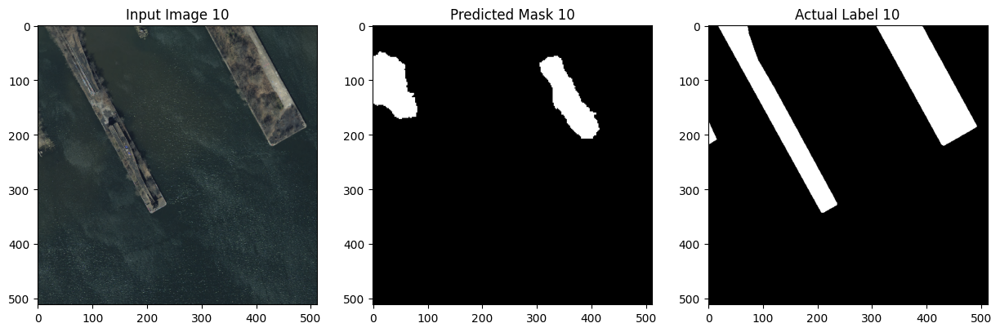

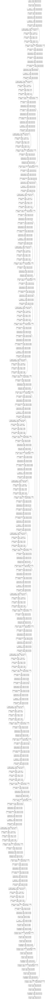

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import load_model
import efficientnet.keras as efn 
import matplotlib.pyplot as plt
import random

# Define the custom metric functions
def iou(y_true, y_pred):
    intersection = K.sum(K.abs(y_true * y_pred), axis=-1)
    union = K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) - intersection
    return (intersection + K.epsilon()) / (union + K.epsilon())

def dice_coef(y_true, y_pred):
    intersection = K.sum(y_true * y_pred, axis=-1)
    return (2. * intersection + K.epsilon()) / (K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) + K.epsilon())

def f1_score(y_true, y_pred):
    precision = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_pred, 0, 1))) + K.epsilon())
    recall = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_true, 0, 1))) + K.epsilon())
    return 2 * (precision * recall) / (precision + recall + K.epsilon())

# Load the saved model with custom metrics
model_path = "/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_efficientnet_512_5_Aug_500epc_0425.h5"
model = load_model(model_path, custom_objects={'iou': iou, 'dice_coef': dice_coef, 'f1_score': f1_score})

# Predict the masks for the entire train data set
predictions = model.predict(train_images_resized)

# Process the predictions
threshold = 0.5
binary_predictions = (predictions > threshold).astype(np.uint8) * 255

# Choose 10 random indices from the train data set
num_samples = 10
random_indices = random.sample(range(len(train_images_resized)), num_samples)

# Display the input images, predicted masks, and actual labels for the chosen indices
for i, index in enumerate(random_indices):
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(train_images_resized[index])
    plt.title(f"Input Image {i + 1}")

    plt.subplot(1, 3, 2)
    plt.imshow(binary_predictions[index].squeeze(), cmap="gray")
    plt.title(f"Predicted Mask {i + 1}")

    plt.subplot(1, 3, 3)
    plt.imshow(train_labels_resized[index].squeeze(), cmap="gray")
    plt.title(f"Actual Label {i + 1}")

    plt.show()

from tensorflow.keras.utils import plot_model

# Assuming 'model' is the name of your model object
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)



### History

         loss  accuracy       iou  dice_coef  f1_score  val_loss  \
0    0.370852  0.846481  0.044949   0.065236  0.122749  0.357349   
1    0.310098  0.862637  0.055819   0.077251  0.419426  0.331188   
2    0.287332  0.877007  0.062154   0.083300  0.484388  0.321168   
3    0.274151  0.884396  0.067386   0.087798  0.504616  0.395122   
4    0.264807  0.888755  0.071844   0.091429  0.522236  0.352354   
..        ...       ...       ...        ...       ...       ...   
495  0.021365  0.990898  0.463397   0.465319  0.961855  0.454530   
496  0.022767  0.990409  0.372801   0.374816  0.960180  0.625974   
497  0.021155  0.990971  0.469039   0.470950  0.962039  0.846258   
498  0.020766  0.991114  0.490544   0.492424  0.963582  0.640913   
499  0.022233  0.990575  0.462180   0.464174  0.960309  0.834130   

     val_accuracy   val_iou  val_dice_coef  val_f1_score  
0        0.829359  0.071511       0.097248      0.286525  
1        0.847293  0.072771       0.098000      0.425000  
2     

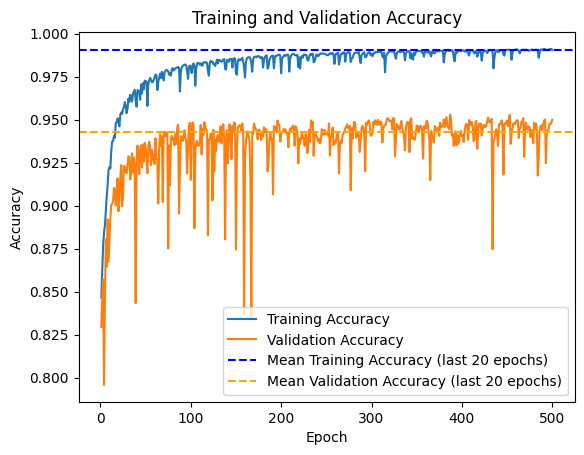

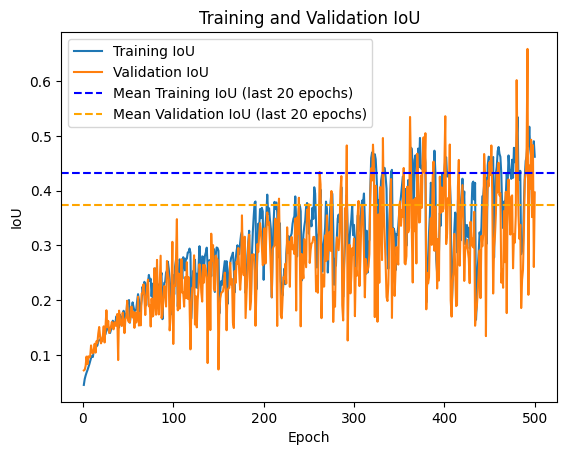

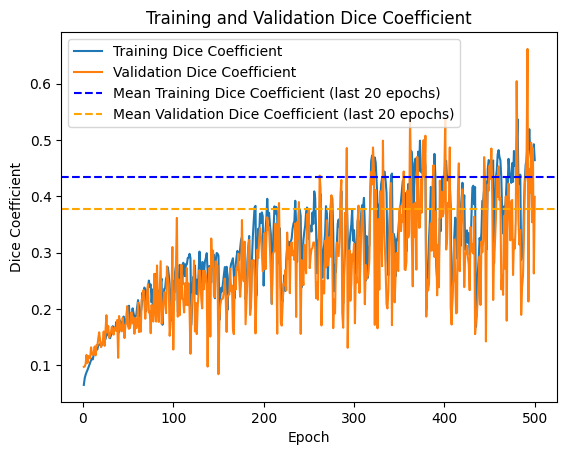

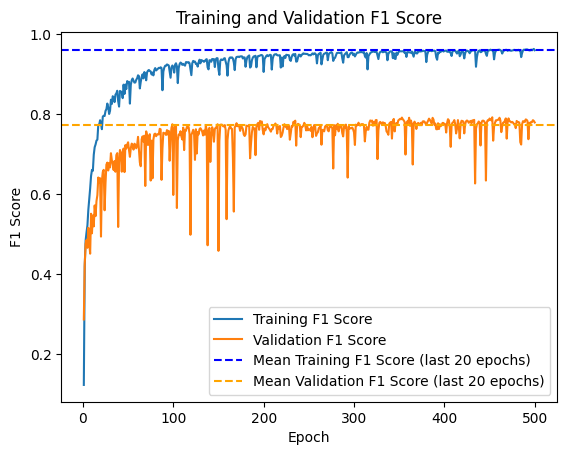

In [ ]:
import json
import pandas as pd
import matplotlib.pyplot as plt

# Load history data from a JSON file
history_filepath = "/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_efficientnet_512_5_Aug_500epc_history_data_0425.json"
with open(history_filepath, "r") as infile:
    history_data = json.load(infile)

# Convert loaded history data to integers for epochs
history_data = {key: [float(value) for value in values] for key, values in history_data.items()}

# Create a DataFrame from the history data
history_df = pd.DataFrame(history_data)

# Display the table of each metric
print(history_df)

# Calculate the mean values for accuracy, IoU, Dice Coefficient, and F1 Score for the last 20 epochs
last_20_epochs_df = history_df.tail(20)
mean_accuracy = last_20_epochs_df["accuracy"].mean()
mean_val_accuracy = last_20_epochs_df["val_accuracy"].mean()
mean_iou = last_20_epochs_df["iou"].mean()
mean_val_iou = last_20_epochs_df["val_iou"].mean()
mean_dice_coef = last_20_epochs_df["dice_coef"].mean()
mean_val_dice_coef = last_20_epochs_df["val_dice_coef"].mean()
mean_f1_score = last_20_epochs_df["f1_score"].mean()
mean_val_f1_score = last_20_epochs_df["val_f1_score"].mean()

# Create a DataFrame to display the mean values as a table
mean_values_df = pd.DataFrame({
    "Metric": ["Training Accuracy", "Validation Accuracy", "Training IoU", "Validation IoU", "Training Dice Coefficient", "Validation Dice Coefficient", "Training F1 Score", "Validation F1 Score"],
    "Mean (last 20 epochs)": [mean_accuracy, mean_val_accuracy, mean_iou, mean_val_iou, mean_dice_coef, mean_val_dice_coef, mean_f1_score, mean_val_f1_score]
})

print("Mean values for the last 20 epochs:")
print(mean_values_df)

# Plot the accuracy of each epoch using the loaded history data
plt.figure()
plt.plot(range(1, len(history_data["accuracy"]) + 1), history_data["accuracy"], label="Training Accuracy")
plt.plot(range(1, len(history_data["val_accuracy"]) + 1), history_data["val_accuracy"], label="Validation Accuracy")
plt.axhline(mean_accuracy, linestyle='--', color='blue', label='Mean Training Accuracy (last 20 epochs)')
plt.axhline(mean_val_accuracy, linestyle='--', color='orange', label='Mean Validation Accuracy (last 20 epochs)')
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend()
plt.title("Training and Validation Accuracy")
plt.show()

# Plot the IoU of each epoch using the loaded history data
plt.figure()
plt.plot(range(1, len(history_data["iou"]) + 1), history_data["iou"], label="Training IoU")
plt.plot(range(1, len(history_data["val_iou"]) + 1), history_data["val_iou"], label="Validation IoU")
plt.axhline(mean_iou, linestyle='--', color='blue', label='Mean Training IoU (last 20 epochs)')
plt.axhline(mean_val_iou, linestyle='--', color='orange', label='Mean Validation IoU (last 20 epochs)')
plt.xlabel("Epoch")
plt.ylabel("IoU")
plt.legend()
plt.title("Training and Validation IoU")
plt.show()

# Plot the Dice Coefficient of each epoch using the loaded history data
plt.figure()
plt.plot(range(1, len(history_data["dice_coef"]) + 1), history_data["dice_coef"], label="Training Dice Coefficient")
plt.plot(range(1, len(history_data["val_dice_coef"]) + 1), history_data["val_dice_coef"], label="Validation Dice Coefficient")
plt.axhline(mean_dice_coef, linestyle='--', color='blue', label='Mean Training Dice Coefficient (last 20 epochs)')
plt.axhline(mean_val_dice_coef, linestyle='--', color='orange', label='Mean Validation Dice Coefficient (last 20 epochs)')
plt.xlabel("Epoch")
plt.ylabel("Dice Coefficient")
plt.legend()
plt.title("Training and Validation Dice Coefficient")
plt.show()

# Plot the F1 Score of each epoch using the loaded history data
plt.figure()
plt.plot(range(1, len(history_data["f1_score"]) + 1), history_data["f1_score"], label="Training F1 Score")
plt.plot(range(1, len(history_data["val_f1_score"]) + 1), history_data["val_f1_score"], label="Validation F1 Score")
plt.axhline(mean_f1_score, linestyle='--', color='blue', label='Mean Training F1 Score (last 20 epochs)')
plt.axhline(mean_val_f1_score, linestyle='--', color='orange', label='Mean Validation F1 Score (last 20 epochs)')
plt.xlabel("Epoch")
plt.ylabel("F1 Score")
plt.legend()
plt.title("Training and Validation F1 Score")
plt.show()



# Three model comparison

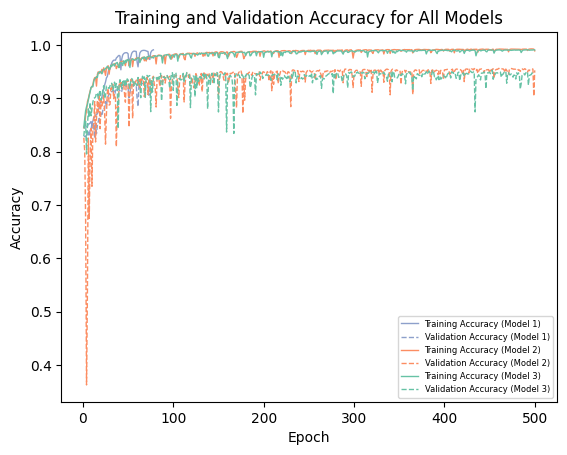

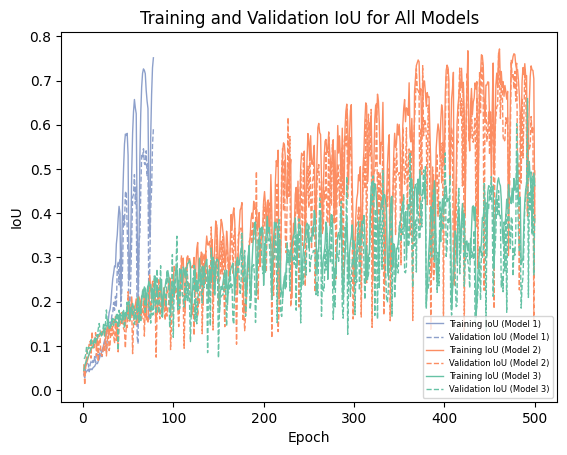

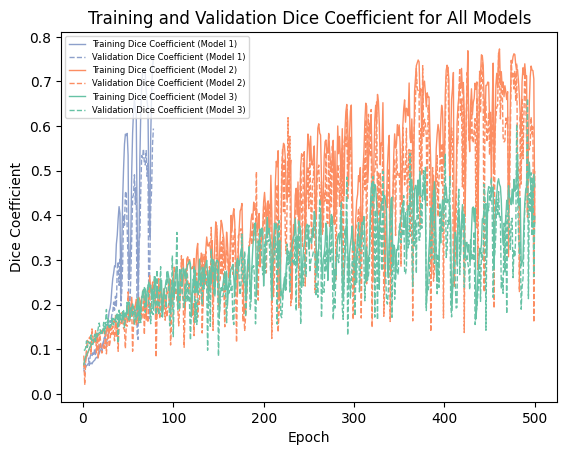

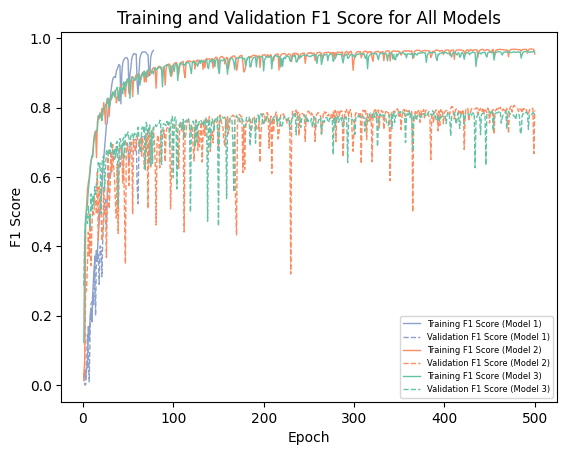

In [ ]:
import json
import pandas as pd
import matplotlib.pyplot as plt

# List of JSON file paths
history_filepaths = [
    "/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_512_5_Aug_500epc_history_data_0425.json",
    "/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_mobilenet_512_5_Aug_500epc_history_data_0425.json",
    "/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_efficientnet_512_5_Aug_500epc_history_data_0425.json"
]

# Load history data from each JSON file
history_data_list = []
for history_filepath in history_filepaths:
    with open(history_filepath, "r") as infile:
        history_data = json.load(infile)
        history_data_list.append(history_data)

# Create DataFrames from the history data
history_df_list = [pd.DataFrame(history_data) for history_data in history_data_list]

# Define a function to plot a specific metric
def plot_metric(metric_name, ylabel, title):
    plt.figure()
    colors = ["#8da0cb", "#fc8d62", "#66c2a5"]
    linewidth = 1  # Set the custom line width


    for i, history_data in enumerate(history_data_list):
        plt.plot(range(1, len(history_data[metric_name]) + 1), history_data[metric_name], color=colors[i], linewidth=linewidth, linestyle='-', label=f"Training {ylabel} (Model {i+1})")
        plt.plot(range(1, len(history_data[f"val_{metric_name}"]) + 1), history_data[f"val_{metric_name}"], color=colors[i],  linewidth=linewidth, linestyle='--', label=f"Validation {ylabel} (Model {i+1})")

    plt.xlabel("Epoch")
    plt.ylabel(ylabel)
    plt.legend(fontsize='6')  # Set the fontsize parameter for smaller label text
    plt.title(title)
    plt.show()


# Plot the accuracy of each epoch using the loaded history data
plot_metric("accuracy", "Accuracy", "Training and Validation Accuracy for All Models")

# Plot the IoU of each epoch using the loaded history data
plot_metric("iou", "IoU", "Training and Validation IoU for All Models")

# Plot the Dice Coefficient of each epoch using the loaded history data
plot_metric("dice_coef", "Dice Coefficient", "Training and Validation Dice Coefficient for All Models")

# Plot the F1 Score of each epoch using the loaded history data
plot_metric("f1_score", "F1 Score", "Training and Validation F1 Score for All Models")


# Predict whole philly

### Import philly image 512 * 512 * 7000 2021

In [ ]:
import os
import rasterio
import numpy as np

def load_tiff_images(folder_path, file_extension=".tif"):
    image_files = sorted([file for file in os.listdir(folder_path) if file.endswith(file_extension)])
    images = []
    input_crs = None
    input_transform = None
    
    for i, file in enumerate(image_files):
        file_path = os.path.join(folder_path, file)
        with rasterio.open(file_path) as src:
            image = src.read().transpose(1, 2, 0)  # Reorder dimensions to (height, width, channels)
            images.append(image)
            
            if i == 0:
                input_crs = src.crs
                input_transform = src.transform
                
        print(f"Loaded image {i+1}/{len(image_files)}: {file}")
    
    return np.array(images), image_files, input_crs, input_transform


# Load images
image_folder = "/content/drive/MyDrive/Remote_Sensing_Project/prediction-2021-512-1000/Split-2021-512"
images_2021, image_files, input_crs, input_transform = load_tiff_images(image_folder)  # Shape: (num_images, height, width, 3)

# print(images_2018.shape)


Loaded image 1/1000: resized_0.tif
Loaded image 2/1000: resized_1.tif
Loaded image 3/1000: resized_10.tif
Loaded image 4/1000: resized_100.tif
Loaded image 5/1000: resized_101.tif
Loaded image 6/1000: resized_102.tif
Loaded image 7/1000: resized_103.tif
Loaded image 8/1000: resized_104.tif
Loaded image 9/1000: resized_105.tif
Loaded image 10/1000: resized_106.tif
Loaded image 11/1000: resized_107.tif
Loaded image 12/1000: resized_108.tif
Loaded image 13/1000: resized_109.tif
Loaded image 14/1000: resized_11.tif
Loaded image 15/1000: resized_110.tif
Loaded image 16/1000: resized_111.tif
Loaded image 17/1000: resized_112.tif
Loaded image 18/1000: resized_113.tif
Loaded image 19/1000: resized_114.tif
Loaded image 20/1000: resized_115.tif
Loaded image 21/1000: resized_116.tif
Loaded image 22/1000: resized_117.tif
Loaded image 23/1000: resized_118.tif
Loaded image 24/1000: resized_119.tif
Loaded image 25/1000: resized_12.tif
Loaded image 26/1000: resized_120.tif
Loaded image 27/1000: resize

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt
import random
from tensorflow.keras import backend as K

# Define the custom metric functions
def iou(y_true, y_pred):
    intersection = K.sum(K.abs(y_true * y_pred), axis=-1)
    union = K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) - intersection
    return (intersection + K.epsilon()) / (union + K.epsilon())

def dice_coef(y_true, y_pred):
    intersection = K.sum(y_true * y_pred, axis=-1)
    return (2. * intersection + K.epsilon()) / (K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) + K.epsilon())

def f1_score(y_true, y_pred):
    precision = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_pred, 0, 1))) + K.epsilon())
    recall = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_true, 0, 1))) + K.epsilon())
    return 2 * (precision * recall) / (precision + recall + K.epsilon())

# Load the saved model with custom metrics
model_path = "/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_mobilenet_512_5_Aug_500epc_0425.h5"
model = load_model(model_path, custom_objects={'iou': iou, 'dice_coef': dice_coef, 'f1_score': f1_score})

# Predict the masks for the entire train data set
predictions = model.predict(images_2021)

# Process the predictions
threshold = 0.5
binary_predictions = (predictions > threshold).astype(np.uint8) * 255

# Save predicted masks as GeoTIFF files with the same CRS as the input images
for i, (image_file, predicted_mask) in enumerate(zip(image_files, binary_predictions)):
    # Save the predicted mask as a GeoTIFF file
    output_filename = f'predicted_mask_{i}.tif'
    predicted_mask = predicted_mask.squeeze()  # Remove the extra dimension
    with rasterio.open(
        output_filename,
        'w',
        driver='GTiff',
        height=predicted_mask.shape[0],
        width=predicted_mask.shape[1],
        count=1,
        dtype=predicted_mask.dtype,
        crs=input_crs,
        transform=input_transform,
    ) as dst:
        dst.write(predicted_mask, 1)


32/32 [==============================] - 11s 69ms/step


In [ ]:
# Choose 100 random indices from the train data set
num_samples = 100
random_indices = random.sample(range(len(images)), num_samples)

# Display the input images, predicted masks, and actual labels for the chosen indices
fig, axs = plt.subplots(num_samples, 2, figsize=(10, 200))

for i, index in enumerate(random_indices):
    axs[i, 0].imshow(images[index])
    axs[i, 0].axis("off")
    axs[i, 0].set_title(f"Input Image {i + 1}")

    prediction_image = binary_predictions[index].squeeze()
    
    axs[i, 1].imshow(prediction_image, cmap="gray")
    axs[i, 1].axis("off")
    axs[i, 1].set_title(f"Predicted Mask {i + 1}")

plt.tight_layout()
plt.show()


In [ ]:
import os
import numpy as np
import rasterio
from skimage import img_as_ubyte
from google.colab import files

# Define the output directory
output_directory = "/content/drive/MyDrive/Remote_Sensing_Project/predict_result_2021_1000"

# Create the output directory if it doesn't exist
if not os.path.exists(output_directory):
    os.makedirs(output_directory)

for i in range(1000):  # Change this line to limit the loop to the first 5 pairs
    # Save the input image
    input_image_filename = os.path.join(output_directory, f"input_image_{i + 1}.tif")
    input_image = (images_2021[i] * 255).astype(np.uint8)
    height, width, _ = input_image.shape

    scaled_input_image = input_image.astype(np.float32) / 255.0

    with rasterio.open(input_image_filename, 'w', driver='GTiff', height=height, width=width, count=3, dtype=scaled_input_image.dtype, crs=input_crs, transform=input_transform) as dst:
        for band_id in range(1, 4):
            dst.write(scaled_input_image[:, :, band_id - 1], band_id)

    # Save the predicted mask
    predicted_mask_filename = os.path.join(output_directory, f"predicted_mask_{i + 1}.tif")
    predicted_mask = binary_predictions[i].squeeze()
    predicted_mask = img_as_ubyte(predicted_mask)
    height, width = predicted_mask.shape

    with rasterio.open(predicted_mask_filename, 'w', driver='GTiff', height=height, width=width, count=1, dtype=predicted_mask.dtype, crs=input_crs, transform=input_transform) as dst:
        dst.write(predicted_mask, 1)



In [ ]:
pip install gdal

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import os
import glob
import cv2
import numpy as np
import rasterio
from osgeo import gdal
from rasterio.plot import show
from shutil import copyfile

def resize_data(img, new_shape):
    resized_img = cv2.resize(img, (new_shape[1], new_shape[0]), interpolation=cv2.INTER_NEAREST)
    return resized_img

predicted_masks_folder = "/content/drive/MyDrive/Remote_Sensing_Project/predict_result_2021_1000"
predicted_mask_files = glob.glob(os.path.join(predicted_masks_folder, 'predicted_mask_*.tif'))

new_shape = (2000, 2000)

# Get pixel size of the first image
predicted_mask_file = predicted_mask_files[0]
src = gdal.Open(predicted_mask_file)
gt = src.GetGeoTransform()
pixel_size_x = gt[1]
pixel_size_y = -gt[5]  # It's usually negative, so we use -gt[5] to get the positive value

print(f"Pixel size (X): {pixel_size_x} meters")
print(f"Pixel size (Y): {pixel_size_y} meters")

total_area_sum = 0

for i, predicted_mask_file in enumerate(predicted_mask_files):
    with rasterio.open(predicted_mask_file) as src:
        img_data = src.read(1)  # Read the single band (mask)
        resized_mask = resize_data(img_data, new_shape)

        # Calculate the count of 255 values in the resized mask
        count_of_255 = np.sum(resized_mask == 255)

        # Calculate the total area
        total_area = count_of_255 * pixel_size_x * pixel_size_y * 0.092903

        print(f"Total area in resized mask {i + 1}: {total_area} square m")
        total_area_sum += total_area

print(f"Total area of all masks: {total_area_sum} square m")
print("Operation completed successfully!")




Pixel size (X): 0.5 meters
Pixel size (Y): 0.5 meters
Total area in resized mask 1: 13448.80086025 square m
Total area in resized mask 2: 8417.91760425 square m
Total area in resized mask 3: 12284.16885225 square m
Total area in resized mask 4: 1000.03111775 square m
Total area in resized mask 5: 8350.42357475 square m
Total area in resized mask 6: 5657.21205625 square m
Total area in resized mask 7: 5030.11680625 square m
Total area in resized mask 8: 12225.50060775 square m
Total area in resized mask 9: 8594.828142 square m
Total area in resized mask 10: 458.847917 square m
Total area in resized mask 11: 936.6015945 square m
Total area in resized mask 12: 453.273737 square m
Total area in resized mask 13: 1713.47970625 square m
Total area in resized mask 14: 19964.27405625 square m
Total area in resized mask 15: 3559.8107025 square m
Total area in resized mask 16: 3712.5432345 square m
Total area in resized mask 17: 0.0 square m
Total area in resized mask 18: 1858.64064375 square m
T

### Import philly image 512 * 512 * 7000 2018

In [ ]:
import os
import rasterio
import numpy as np

def load_tiff_images(folder_path, file_extension=".tif"):
    image_files = sorted([file for file in os.listdir(folder_path) if file.endswith(file_extension)])
    images = []
    input_crs = None
    input_transform = None
    
    for i, file in enumerate(image_files):
        file_path = os.path.join(folder_path, file)
        with rasterio.open(file_path) as src:
            image = src.read().transpose(1, 2, 0)  # Reorder dimensions to (height, width, channels)
            images.append(image)
            
            if i == 0:
                input_crs = src.crs
                input_transform = src.transform
                
        print(f"Loaded image {i+1}/{len(image_files)}: {file}")
    
    return np.array(images), image_files, input_crs, input_transform


# Load images
image_folder = "/content/drive/MyDrive/Remote_Sensing_Project/2018-512/2018-512"
images_2018, image_files, input_crs, input_transform = load_tiff_images(image_folder)  # Shape: (num_images, height, width, 3)

# print(images_2018.shape)


Loaded image 1/1000: resized_0.tif
Loaded image 2/1000: resized_1.tif
Loaded image 3/1000: resized_10.tif
Loaded image 4/1000: resized_100.tif
Loaded image 5/1000: resized_101.tif
Loaded image 6/1000: resized_102.tif
Loaded image 7/1000: resized_103.tif
Loaded image 8/1000: resized_104.tif
Loaded image 9/1000: resized_105.tif
Loaded image 10/1000: resized_106.tif
Loaded image 11/1000: resized_107.tif
Loaded image 12/1000: resized_108.tif
Loaded image 13/1000: resized_109.tif
Loaded image 14/1000: resized_11.tif
Loaded image 15/1000: resized_110.tif
Loaded image 16/1000: resized_111.tif
Loaded image 17/1000: resized_112.tif
Loaded image 18/1000: resized_113.tif
Loaded image 19/1000: resized_114.tif
Loaded image 20/1000: resized_115.tif
Loaded image 21/1000: resized_116.tif
Loaded image 22/1000: resized_117.tif
Loaded image 23/1000: resized_118.tif
Loaded image 24/1000: resized_119.tif
Loaded image 25/1000: resized_12.tif
Loaded image 26/1000: resized_120.tif
Loaded image 27/1000: resize

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt
import random
from tensorflow.keras import backend as K

# Define the custom metric functions
def iou(y_true, y_pred):
    intersection = K.sum(K.abs(y_true * y_pred), axis=-1)
    union = K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) - intersection
    return (intersection + K.epsilon()) / (union + K.epsilon())

def dice_coef(y_true, y_pred):
    intersection = K.sum(y_true * y_pred, axis=-1)
    return (2. * intersection + K.epsilon()) / (K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) + K.epsilon())

def f1_score(y_true, y_pred):
    precision = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_pred, 0, 1))) + K.epsilon())
    recall = K.sum(K.round(K.clip(y_true * y_pred, 0, 1))) / (K.sum(K.round(K.clip(y_true, 0, 1))) + K.epsilon())
    return 2 * (precision * recall) / (precision + recall + K.epsilon())

# Load the saved model with custom metrics
model_path = "/content/drive/MyDrive/Remote_Sensing_Project/vacant_lot_segmentation_model_mobilenet_512_5_Aug_500epc_0425.h5"
model = load_model(model_path, custom_objects={'iou': iou, 'dice_coef': dice_coef, 'f1_score': f1_score})

# Predict the masks for the entire train data set
predictions = model.predict(images_2018)

# Process the predictions
threshold = 0.5
binary_predictions = (predictions > threshold).astype(np.uint8) * 255

# Save predicted masks as GeoTIFF files with the same CRS as the input images
for i, (image_file, predicted_mask) in enumerate(zip(image_files, binary_predictions)):
    # Save the predicted mask as a GeoTIFF file
    output_filename = f'predicted_mask_{i}.tif'
    predicted_mask = predicted_mask.squeeze()  # Remove the extra dimension
    with rasterio.open(
        output_filename,
        'w',
        driver='GTiff',
        height=predicted_mask.shape[0],
        width=predicted_mask.shape[1],
        count=1,
        dtype=predicted_mask.dtype,
        crs=input_crs,
        transform=input_transform,
    ) as dst:
        dst.write(predicted_mask, 1)


32/32 [==============================] - 3s 59ms/step


In [ ]:
import os
import numpy as np
import rasterio
from skimage import img_as_ubyte
from google.colab import files

# Define the output directory
output_directory = "/content/drive/MyDrive/Remote_Sensing_Project/predict_result_2018_1000"

# Create the output directory if it doesn't exist
if not os.path.exists(output_directory):
    os.makedirs(output_directory)

for i in range(1000):  # Change this line to limit the loop to the first 5 pairs
    # Save the input image
    input_image_filename = os.path.join(output_directory, f"input_image_{i + 1}.tif")
    input_image = (images_2018[i] * 255).astype(np.uint8)
    height, width, _ = input_image.shape

    scaled_input_image = input_image.astype(np.float32) / 255.0

    with rasterio.open(input_image_filename, 'w', driver='GTiff', height=height, width=width, count=3, dtype=scaled_input_image.dtype, crs=input_crs, transform=input_transform) as dst:
        for band_id in range(1, 4):
            dst.write(scaled_input_image[:, :, band_id - 1], band_id)

    # Save the predicted mask
    predicted_mask_filename = os.path.join(output_directory, f"predicted_mask_{i + 1}.tif")
    predicted_mask = binary_predictions[i].squeeze()
    predicted_mask = img_as_ubyte(predicted_mask)
    height, width = predicted_mask.shape

    with rasterio.open(predicted_mask_filename, 'w', driver='GTiff', height=height, width=width, count=1, dtype=predicted_mask.dtype, crs=input_crs, transform=input_transform) as dst:
        dst.write(predicted_mask, 1)

In [ ]:
import os
import glob
import cv2
import numpy as np
import rasterio
from osgeo import gdal
from rasterio.plot import show
from shutil import copyfile

def resize_data(img, new_shape):
    resized_img = cv2.resize(img, (new_shape[1], new_shape[0]), interpolation=cv2.INTER_NEAREST)
    return resized_img

predicted_masks_folder = "/content/drive/MyDrive/Remote_Sensing_Project/predict_result_2018_1000"
predicted_mask_files = glob.glob(os.path.join(predicted_masks_folder, 'predicted_mask_*.tif'))

new_shape = (2000, 2000)

# Get pixel size of the first image
predicted_mask_file = predicted_mask_files[0]
src = gdal.Open(predicted_mask_file)
gt = src.GetGeoTransform()
pixel_size_x = gt[1]
pixel_size_y = -gt[5]  # It's usually negative, so we use -gt[5] to get the positive value

print(f"Pixel size (X): {pixel_size_x} meters")
print(f"Pixel size (Y): {pixel_size_y} meters")

total_area_sum = 0

for i, predicted_mask_file in enumerate(predicted_mask_files):
    with rasterio.open(predicted_mask_file) as src:
        img_data = src.read(1)  # Read the single band (mask)
        resized_mask = resize_data(img_data, new_shape)

        # Calculate the count of 255 values in the resized mask
        count_of_255 = np.sum(resized_mask == 255)

        # Calculate the total area
        total_area = count_of_255 * pixel_size_x * pixel_size_y * 0.092903

        print(f"Total area in resized mask {i + 1}: {total_area} square m")
        total_area_sum += total_area

print(f"Total area of all masks: {total_area_sum} square m")
print("Operation completed successfully!")



Pixel size (X): 0.5 meters
Pixel size (Y): 0.5 meters
Total area in resized mask 1: 199.648547 square m
Total area in resized mask 2: 1154.4591295 square m
Total area in resized mask 3: 748.86785725 square m
Total area in resized mask 4: 460.45049375 square m
Total area in resized mask 5: 3538.7217215 square m
Total area in resized mask 6: 4265.548342 square m
Total area in resized mask 7: 742.573679 square m
Total area in resized mask 8: 3192.797401 square m
Total area in resized mask 9: 214.39689825 square m
Total area in resized mask 10: 695.5183095 square m
Total area in resized mask 11: 713.7272975 square m
Total area in resized mask 12: 343.39271375 square m
Total area in resized mask 13: 1138.6656195 square m
Total area in resized mask 14: 19462.78366225 square m
Total area in resized mask 15: 1254.469209 square m
Total area in resized mask 16: 42.549574 square m
Total area in resized mask 17: 122.8642175 square m
Total area in resized mask 18: 55.277285 square m
Total area in r